In [1]:
# necessary for data import
import numpy as np

from tqdm import tqdm
import matplotlib.pyplot as plt

import skimage as sk


from skimage.transform import resize

import matplotlib.patches as patches

import torch



from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils


import torch.nn as nn
import torch.nn.functional as F


from sklearn.model_selection import train_test_split




import random

In [2]:
import torchvision

In [3]:
import math

In [4]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Using {} device'.format(device))


Using cuda device


box: top, left, width, height

'image', 'box', 'keypoints'

In [5]:
def show_cropped_image_with_points_data_things(Xs, ys, figsize=(4, 5)):
#     if not isinstance(X, np.ndarray):
#         X = X.cpu().detach().numpy()
    
#     if not isinstance(y, np.ndarray):
#         y = y.cpu().detach().numpy()
    
    
    
#     X = X.transpose((1, 2, 0))
    
#     y = y.reshape((68, 2))
    
#     fig = plt.figure(figsize=figsize)
    
#     ax = fig.subplots()
#     ax.imshow(X)

#     ax.scatter(*zip(*(y * X.shape[0])))
    
    if not isinstance(Xs, np.ndarray):
        Xs= Xs.cpu().detach().numpy()

    if not isinstance(ys, np.ndarray):
        ys = ys.cpu().detach().numpy()

    
    
    num_rows = len(Xs)//6
    num_cols = 6
    
    fig = plt.figure(figsize=(figsize[0] * num_cols, figsize[1] * num_rows))
    subplots = fig.subplots(num_rows, num_cols, squeeze = False)
    
    for row in range(num_rows):
        for col in range(num_cols):
            
            ax = subplots[row, col]
            
            X = Xs[row*6 + col]
            y = ys[row*6 + col]
            
            



            # X = X.transpose((1, 2, 0))

            y = y.reshape((68, 2))


            ax.imshow(X)

            ax.scatter(*zip(*(y * X.shape[0])))

            
            ax.set_axis_off()
            




In [6]:
def show_cropped_image_with_points_data_thing(X, y, figsize=(4, 5)):
    if not isinstance(X, np.ndarray):
        X = X.cpu().detach().numpy()
    
    if not isinstance(y, np.ndarray):
        y = y.cpu().detach().numpy()
    
    X = X.transpose((1, 2, 0))
    
    y = y.reshape((68, 2))
    
    fig = plt.figure(figsize=figsize)
    
    ax = fig.subplots()
    ax.imshow(X)

    ax.scatter(*zip(*(y * X.shape[0])))



In [7]:
X_all = np.load('data/all_x.npy')
y_all = np.load('data/all_y.npy')

In [6]:
X_all.shape

(6666, 250, 250, 3)

In [7]:
y_all.shape

(6666, 68, 2)

In [8]:
def train(dataloader, model, loss_fn, optimizer):
    
    size = len(dataloader.dataset)
    model.train()
    
    total_loss = 0
    
    for bidx, batch in tqdm(enumerate(dataloader)):
        
        # send data to gpu
        x, y = batch['image'], batch['keypoints']
        x, y = x.to(device), y.to(device)
        
        # do the forward/backward pass
        model.zero_grad()
        output = model(x)
        loss = loss_fn(output,y)
        loss.backward()
        optimizer.step()
        
        total_loss += float(loss)
        
        del x
        del y
        
        
    mean_loss = total_loss/(bidx + 1)
        
    return mean_loss

def validate(dataloader, model, loss_fn):
    
    size = len(dataloader.dataset)
    model.eval()
    
    total_loss = 0
    
    for bidx, batch in enumerate(dataloader):
        
        # send data to gpu
        x, y = batch['image'], batch['keypoints']
        x, y = x.to(device), y.to(device)
        
        # do the forward pass
        output = model(x)
        loss = loss_fn(output,y)      
        total_loss += float(loss)
        
        del x
        del y
        
    mean_loss = total_loss/(bidx + 1)
        
    return mean_loss

def predict(dataloader, model):
    
    outputs = []
    model.eval()
    for bidx, batch in enumerate(dataloader):
        
        # send data to gpu
        x = batch['image']
        x = x.to(device)
        
        # do the forward pass and convert to np array
        output = model(x).cpu().detach().numpy()
        
        
        outputs.append(output)
        
        
        del x
    
    all_outputs = np.vstack(outputs)

    return all_outputs
        


### Split data into training and validation

In [9]:
X_train, X_val, y_train, y_val = train_test_split(X_all, y_all, test_size=1800, random_state=69, shuffle = True)

In [10]:
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((4866, 250, 250, 3), (1800, 250, 250, 3), (4866, 68, 2), (1800, 68, 2))

###  dataset with augmentation (final)

In [9]:
class AddGaussianNoise(object):
    def __init__(self, p = 1, mean=0., std=0.05):
        self.std = std
        self.mean = mean
        self.prob = p
        
    def __call__(self, tensor):
        if random.random() < self.prob:
            return tensor + torch.randn(tensor.size()) * self.std + self.mean
        else:
            return tensor
    
    def __repr__(self):
        return self.__class__.__name__ + '(mean={0}, std={1})'.format(self.mean, self.std)


In [10]:
class KeypointsDataset224_aug(Dataset):
    """Face Landmarks dataset."""

    def __init__(self,X, y, do_aug, img_size = 224, normalize = False):
        
        
        assert len(X) == len(y)
        
        self.img_size = img_size
        
        self.do_aug = do_aug
        
        
        if do_aug:
            self.no_move_transforms = transforms.Compose([
                transforms.ColorJitter(brightness = .7, contrast=.3, saturation=.7,hue=.1),
                transforms.RandomGrayscale(p=0.13),
                AddGaussianNoise(p = 0.5)
                ])
            # self.no_move_transforms = transforms.Resize(img_size)
                
                
                
                
        if normalize:
            self.transform = transforms.Compose([
            transforms.Resize(img_size),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])
        else:
            self.transform = transforms.Resize(img_size)
        
        
        X = X.transpose(0, 3, 1, 2)
        
        X = (X.astype(float))/255
        
        y = y.reshape((len(y), 136))
                    
        self.faces = torch.Tensor(X)
        
        self.keypoints = torch.Tensor(y)
        
    def image_aug_transforms(self, sample):
        image, keypoints = sample['image'], sample['keypoints']
        
        image = self.no_move_transforms(image)
        
        keypoints2d = torch.reshape(keypoints, (68, 2))
            
        if random.random() > 0.3:
            # do rotation
            angle = random.randint(-20, 20)
            
            image = transforms.functional.rotate(image, angle)
            theta = torch.tensor(-angle * math.pi / 180)
            c, s = torch.cos(theta), torch.sin(theta)
            rot = torch.stack([torch.stack([c, s]),
                   torch.stack([-s, c])])
            
            
            keypoints2d = keypoints2d - 0.5
            
            keypoints2d_rot = keypoints2d @ rot
            
            keypoints2d_rot = keypoints2d_rot + 0.5
            keypoints2d = keypoints2d_rot
        
        if random.random()>0.3:
            # do perspective warp
            startpoints = [
                [0, 0],
                [self.img_size, 0],
                [self.img_size, self.img_size],
                [0, self.img_size]
            ]
            def offset(x):
                return x + (self.img_size * random.uniform(-0.2, 0.2))
            
            shift_x = 0
            shift_y = 0
            if random.random() > 0.4:
                shift_x = random.uniform(-0.2, 0.2)
                shift_y = random.uniform(-0.2, 0.2)
            
            endpoints = [
                [offset(0) + shift_x, offset(0) + shift_y],
                [offset(self.img_size) + shift_x, offset(0) + shift_y],
                [offset(self.img_size) + shift_x, offset(self.img_size) + shift_y],
                [offset(0) + shift_x, offset(self.img_size) + shift_y]
            ]
            
            image = transforms.functional.perspective(image, startpoints, endpoints)
            a, b, c, d, e, f, g, h = transforms.functional._get_perspective_coeffs(endpoints, startpoints)
            
            keypoints2d = keypoints2d * self.img_size
            xs_old, ys_old = keypoints2d[:,0:1], keypoints2d[:,1:]
            
            xs_new = (a*xs_old + b*ys_old + c)/(g*xs_old + h*ys_old + 1)
            ys_new = (d*xs_old + e*ys_old + f)/(g*xs_old + h*ys_old + 1)
            
            
            keypoints2d = torch.hstack((xs_new, ys_new))
            keypoints2d = keypoints2d / self.img_size
            
            
            
        return {'image': image, 'keypoints': torch.flatten(keypoints2d)}
        
        
    def __len__(self):
        return len(self.keypoints)

    def __getitem__(self, idx):
        
        if torch.is_tensor(idx):
            idx = idx.tolist()

        
        sample = {'image': self.transform(self.faces[idx]), 'keypoints': self.keypoints[idx]}

        if self.do_aug:
            sample = self.image_aug_transforms(sample)
            
        
        return sample



In [10]:
train_dataset_ra = KeypointsDataset224_aug(X_train, y_train, True)
val_dataset_ra = KeypointsDataset224_aug(X_val, y_val, False)

NameError: name 'X_train' is not defined

### Simple Dataset

In [38]:
class KeypointsDataset(Dataset):
    """Face Landmarks dataset."""

    def __init__(self,X, y, transform=None):
        
        assert len(X) == len(y)
        
        self.transform = transform
        
        
        X = X.transpose(0, 3, 1, 2)
        
        X = (X.astype(float))/255
        
        y = y.reshape((len(y), 136))
                    
        self.faces = torch.Tensor(X)
        
        self.keypoints = torch.Tensor(y)
        
    def __len__(self):
        return len(self.keypoints)

    def __getitem__(self, idx):
        
        if torch.is_tensor(idx):
            idx = idx.tolist()

        
        sample = {'image': self.faces[idx], 'keypoints': self.keypoints[idx]}

        if self.transform:
            sample = self.transform(sample)

        return sample


In [13]:
train_dataset = KeypointsDataset(X_train, y_train)
val_dataset = KeypointsDataset(X_val, y_val)

### size 224 dataset for resnet

In [39]:
class KeypointsDataset224(Dataset):
    """Face Landmarks dataset."""

    def __init__(self,X, y, transform=None):
        
        assert len(X) == len(y)
        
        self.transform = transforms.Resize(224)
        
        
        X = X.transpose(0, 3, 1, 2)
        
        X = (X.astype(float))/255
        
        y = y.reshape((len(y), 136))
                    
        self.faces = torch.Tensor(X)
        
        self.keypoints = torch.Tensor(y)
        
    def __len__(self):
        return len(self.keypoints)

    def __getitem__(self, idx):
        
        if torch.is_tensor(idx):
            idx = idx.tolist()

        
        sample = {'image': self.transform(self.faces[idx]), 'keypoints': self.keypoints[idx]}


        return sample



In [40]:
train_dataset_r = KeypointsDataset224(X_train, y_train)
val_dataset_r = KeypointsDataset224(X_val, y_val)

### Model 1

In [14]:
train_dataset[1]['image'].shape

torch.Size([3, 250, 250])

In [234]:
def weight_reset(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
        m.reset_parameters()

In [17]:
BATCH_SIZE = 4
NUM_EPOCHS = 25

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)

In [19]:
class KeypointModel(nn.Module):

    def __init__(self):
        super(KeypointModel, self).__init__()
        # 1 input image channel, 12 output channels, 5x5 square convolution
        # kernel
        
        self.conv1 = nn.Conv2d(3, 12, 8)
        
        
        
        self.conv2 = nn.Conv2d(12, 12, 8)
        self.conv3 = nn.Conv2d(12, 12, 8)
        self.conv4 = nn.Conv2d(12, 12, 8)
        self.conv5 = nn.Conv2d(12, 12, 8)
        # an affine operation: y = Wx + b
        self.fc1 = nn.Linear(768, 200)  # 5*5 from image dimension
        self.fc2 = nn.Linear(200, 136)

    def forward(self, x):
        
        # 250 x 250, 12
        x = self.conv1(x)
        x = F.relu(x)
        # 243 x 243, 12
        x = F.relu(self.conv2(x))
        # 236 x 236, 12
        x = F.max_pool2d(x, 2)
        # 118 x 118, 12
        x = F.relu(self.conv3(x))
        # 111 x 111, 12
        x = F.max_pool2d(x, 2)
        # 55 x 55, 12
        x = F.relu(self.conv4(x))
        # 48 x 48, 12
        x = F.max_pool2d(x, 2)
        # 24 x 24, 12
        x = F.relu(self.conv5(x))
        # 17 x 17, 12
        x = F.max_pool2d(x, 2)
        # 8 x 8, 12
        x = torch.flatten(x, 1) # flatten all dimensions except the batch dimension
        
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x


In [20]:
torch.cuda.empty_cache()

In [ ]:
del model

In [23]:
model = KeypointModel().to(device)
print(model)

KeypointModel(
  (conv1): Conv2d(3, 12, kernel_size=(8, 8), stride=(1, 1))
  (conv2): Conv2d(12, 12, kernel_size=(8, 8), stride=(1, 1))
  (conv3): Conv2d(12, 12, kernel_size=(8, 8), stride=(1, 1))
  (conv4): Conv2d(12, 12, kernel_size=(8, 8), stride=(1, 1))
  (conv5): Conv2d(12, 12, kernel_size=(8, 8), stride=(1, 1))
  (fc1): Linear(in_features=768, out_features=200, bias=True)
  (fc2): Linear(in_features=200, out_features=136, bias=True)
)


In [24]:
train_loss_history = []
val_loss_history = []
model.apply(weight_reset)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.MSELoss()

In [25]:
for epoch in range(NUM_EPOCHS):
    train_loss = train(train_loader, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

training on 4866 samples


1217it [00:07, 166.76it/s]


validating on 1800 samples
epoch 0, train_loss 0.003866773153136384, val_loss 0.001937327218733521
training on 4866 samples


1217it [00:06, 180.05it/s]


validating on 1800 samples
epoch 1, train_loss 0.0018439188824334062, val_loss 0.0017839225229626108
training on 4866 samples


1217it [00:06, 179.86it/s]


validating on 1800 samples
epoch 2, train_loss 0.0017954931417369147, val_loss 0.0018958060905182113
training on 4866 samples


1217it [00:06, 179.31it/s]


validating on 1800 samples
epoch 3, train_loss 0.0016572464018047694, val_loss 0.0016031757910321984
training on 4866 samples


1217it [00:06, 179.22it/s]


validating on 1800 samples
epoch 4, train_loss 0.001005361888295762, val_loss 0.0006816396608094995
training on 4866 samples


1217it [00:06, 179.10it/s]


validating on 1800 samples
epoch 5, train_loss 0.0006231592696127746, val_loss 0.0005443129270052951
training on 4866 samples


1217it [00:06, 179.42it/s]


validating on 1800 samples
epoch 6, train_loss 0.0005430078629734134, val_loss 0.000543348734079498
training on 4866 samples


1217it [00:06, 179.10it/s]


validating on 1800 samples
epoch 7, train_loss 0.0005179501590059746, val_loss 0.0005678212709608487
training on 4866 samples


1217it [00:06, 179.44it/s]


validating on 1800 samples
epoch 8, train_loss 0.00048036974223522697, val_loss 0.0005115977342939005
training on 4866 samples


1217it [00:06, 178.47it/s]


validating on 1800 samples
epoch 9, train_loss 0.000464389877147619, val_loss 0.0004387818239047192
training on 4866 samples


1217it [00:06, 178.06it/s]


validating on 1800 samples
epoch 10, train_loss 0.00044637548050119243, val_loss 0.00048019281591728534
training on 4866 samples


1217it [00:06, 177.84it/s]


validating on 1800 samples
epoch 11, train_loss 0.00042233685238249357, val_loss 0.0004598728115282332
training on 4866 samples


1217it [00:06, 177.97it/s]


validating on 1800 samples
epoch 12, train_loss 0.00039519029853843693, val_loss 0.0004497518350318488
training on 4866 samples


1217it [00:06, 178.38it/s]


validating on 1800 samples
epoch 13, train_loss 0.00038715330834118624, val_loss 0.0004059734339373083
training on 4866 samples


1217it [00:06, 177.97it/s]


validating on 1800 samples
epoch 14, train_loss 0.0003858945121028347, val_loss 0.00040391456992236067
training on 4866 samples


1217it [00:06, 178.07it/s]


validating on 1800 samples
epoch 15, train_loss 0.00037256679385381077, val_loss 0.0004045256075914949
training on 4866 samples


1217it [00:06, 177.70it/s]


validating on 1800 samples
epoch 16, train_loss 0.00035573844204832023, val_loss 0.0004022978477102394
training on 4866 samples


1217it [00:06, 177.90it/s]


validating on 1800 samples
epoch 17, train_loss 0.000404481879787404, val_loss 0.0004263722907894084
training on 4866 samples


1217it [00:06, 178.23it/s]


validating on 1800 samples
epoch 18, train_loss 0.0003476625754230678, val_loss 0.0003920570327965025
training on 4866 samples


1217it [00:06, 177.79it/s]


validating on 1800 samples
epoch 19, train_loss 0.00033526126859684176, val_loss 0.00040948319158309865
training on 4866 samples


1217it [00:06, 178.06it/s]


validating on 1800 samples
epoch 20, train_loss 0.0003414067739788971, val_loss 0.00039815542061761433
training on 4866 samples


1217it [00:06, 177.84it/s]


validating on 1800 samples
epoch 21, train_loss 0.0003203228595160559, val_loss 0.0004027188788556183
training on 4866 samples


1217it [00:06, 177.84it/s]


validating on 1800 samples
epoch 22, train_loss 0.00032082360728847393, val_loss 0.00046016460249019374
training on 4866 samples


1217it [00:06, 178.01it/s]


validating on 1800 samples
epoch 23, train_loss 0.00033251247931458897, val_loss 0.0003955844403632606
training on 4866 samples


1217it [00:06, 177.90it/s]


validating on 1800 samples
epoch 24, train_loss 0.0003152642031125617, val_loss 0.00038534518654665187


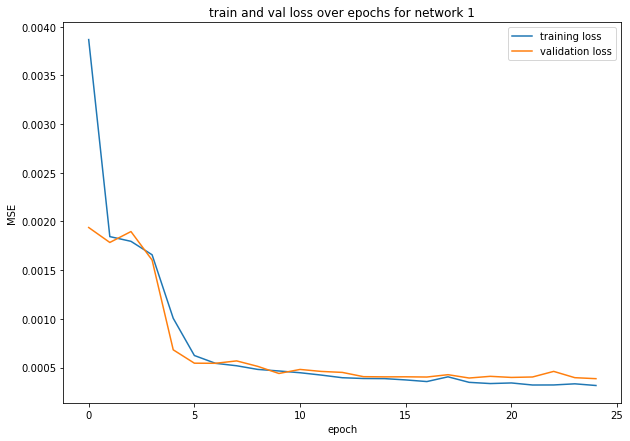

In [26]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.title('train and val loss over epochs for network 1')
plt.legend()


In [34]:
y_predict = predict(val_loader, model)

(1800, 136)


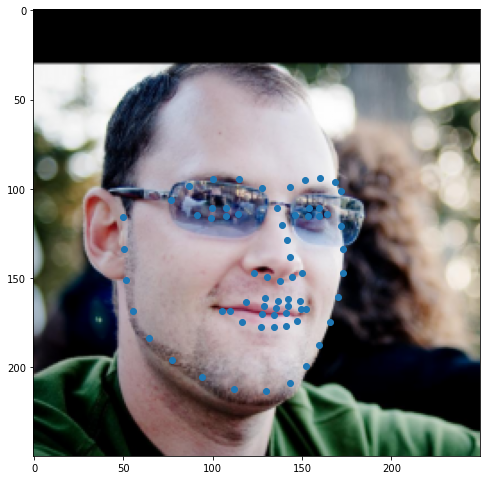

In [43]:
show_cropped_image_with_points_data_thing(val_dataset[666]['image'], y_predict[666])



### Model 2 (eliminated)

In [40]:
class KeypointModel2(nn.Module):
    # wider but shallower
    def __init__(self):
        super(KeypointModel2, self).__init__()
        # 1 input image channel, 12 output channels, 5x5 square convolution
        # kernel
        self.conv1 = nn.Conv2d(3, 32, 14)
        self.conv2 = nn.Conv2d(32, 32, 12)
        self.conv3 = nn.Conv2d(32, 32, 10)
        self.conv4 = nn.Conv2d(32, 12, 8)
        # an affine operation: y = Wx + b
        self.fc1 = nn.Linear(2700, 500)  # 5*5 from image dimension
        self.fc2 = nn.Linear(500, 136)

    def forward(self, x):
        
        # 250
        x = self.conv1(x)
        x = F.relu(x)
        # 237
        x = F.relu(self.conv2(x))
        # 226
        x = F.max_pool2d(x, 2)
        # 113
        x = F.relu(self.conv3(x))
        # 104
        x = F.max_pool2d(x, 2)
        # 52
        x = F.relu(self.conv4(x))
        # 45
        x = F.max_pool2d(x, 3)
        # 15
        x = torch.flatten(x, 1) # flatten all dimensions except the batch dimension
        
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x



In [55]:
BATCH_SIZE = 4
NUM_EPOCHS = 10

In [56]:
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)

In [53]:
model = KeypointModel2().to(device)
print(model)

KeypointModel2(
  (conv1): Conv2d(3, 32, kernel_size=(14, 14), stride=(1, 1))
  (conv2): Conv2d(32, 32, kernel_size=(12, 12), stride=(1, 1))
  (conv3): Conv2d(32, 32, kernel_size=(10, 10), stride=(1, 1))
  (conv4): Conv2d(32, 12, kernel_size=(8, 8), stride=(1, 1))
  (fc1): Linear(in_features=2700, out_features=500, bias=True)
  (fc2): Linear(in_features=500, out_features=136, bias=True)
)


In [57]:
train_loss_history = []
val_loss_history = []
model.apply(weight_reset)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.MSELoss()

In [58]:
for epoch in range(NUM_EPOCHS):
    train_loss = train(train_loader, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

training on 4866 samples


1217it [00:22, 54.42it/s]


validating on 1800 samples
epoch 0, train_loss 0.024788876077465962, val_loss 0.0017122265486977995
training on 4866 samples


1217it [00:22, 54.19it/s]


validating on 1800 samples
epoch 1, train_loss 0.0016676969481136607, val_loss 0.0017267055595422992
training on 4866 samples


1217it [00:22, 54.04it/s]


validating on 1800 samples
epoch 2, train_loss 0.0016799849048767686, val_loss 0.0017379120961090342
training on 4866 samples


1217it [00:22, 53.84it/s]


validating on 1800 samples
epoch 3, train_loss 0.0016853155088471287, val_loss 0.0017364408525948722
training on 4866 samples


1217it [00:22, 53.85it/s]


validating on 1800 samples
epoch 4, train_loss 0.0016866942741655597, val_loss 0.0017349220050447104
training on 4866 samples


1217it [00:22, 53.86it/s]


validating on 1800 samples
epoch 5, train_loss 0.0016864186455380866, val_loss 0.0017335504091655215
training on 4866 samples


1217it [00:22, 53.83it/s]


validating on 1800 samples
epoch 6, train_loss 0.001685556078742158, val_loss 0.0017322686575223796
training on 4866 samples


1217it [00:22, 53.82it/s]


validating on 1800 samples
epoch 7, train_loss 0.001684615278865066, val_loss 0.0017310814355732873
training on 4866 samples


1217it [00:22, 53.83it/s]


validating on 1800 samples
epoch 8, train_loss 0.0016835751342464732, val_loss 0.001729799490680711
training on 4866 samples


1217it [00:22, 53.80it/s]


validating on 1800 samples
epoch 9, train_loss 0.0016826728902247887, val_loss 0.0017289318904254792


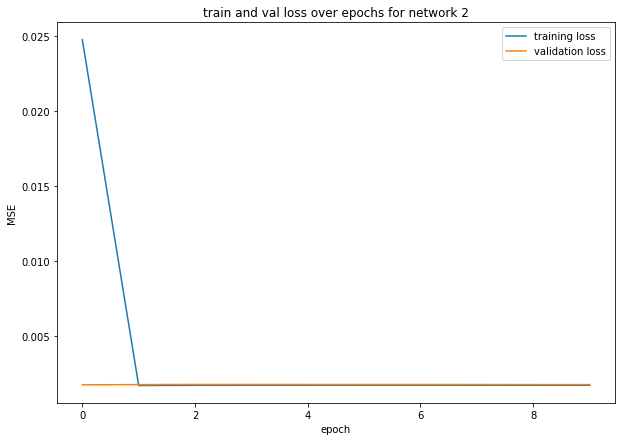

In [60]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.title('train and val loss over epochs for network 2')
plt.legend()



### Model 3 (resnet 34), pretrained

In [41]:
BATCH_SIZE = 4
NUM_EPOCHS = 25

train_loader_r = DataLoader(train_dataset_r, batch_size=BATCH_SIZE)
val_loader_r = DataLoader(val_dataset_r, batch_size=BATCH_SIZE)

In [42]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet34', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [43]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

In [44]:
model = model.to(device)

In [45]:
train_loss_history = []
val_loss_history = []
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.MSELoss()

In [46]:
for epoch in range(NUM_EPOCHS):
    train_loss = train(train_loader_r, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_r, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

training on 4866 samples


1217it [00:30, 40.55it/s]


validating on 1800 samples
epoch 0, train_loss 0.0032687396894259977, val_loss 0.0006668729229002363
training on 4866 samples


1217it [00:29, 41.16it/s]


validating on 1800 samples
epoch 1, train_loss 0.0008158659923432552, val_loss 0.0005448384380563059
training on 4866 samples


1217it [00:29, 40.82it/s]


validating on 1800 samples
epoch 2, train_loss 0.0005346924594477976, val_loss 0.0003756198068731464
training on 4866 samples


1217it [00:29, 41.45it/s]


validating on 1800 samples
epoch 3, train_loss 0.0004465829667903295, val_loss 0.0005018448750747161
training on 4866 samples


1217it [00:29, 41.01it/s]


validating on 1800 samples
epoch 4, train_loss 0.00044184119597780647, val_loss 0.0005105139169609174
training on 4866 samples


1217it [00:29, 41.22it/s]


validating on 1800 samples
epoch 5, train_loss 0.0003796502769860227, val_loss 0.0004405958331901477
training on 4866 samples


1217it [00:29, 41.08it/s]


validating on 1800 samples
epoch 6, train_loss 0.0003724898766268916, val_loss 0.00034631805879244994
training on 4866 samples


1217it [00:29, 41.38it/s]


validating on 1800 samples
epoch 7, train_loss 0.0003735123304151811, val_loss 0.00030888212356431824
training on 4866 samples


1217it [00:29, 41.49it/s]


validating on 1800 samples
epoch 8, train_loss 0.00029857147814630014, val_loss 0.0003148841666471627
training on 4866 samples


1217it [00:29, 41.48it/s]


validating on 1800 samples
epoch 9, train_loss 0.0002860492141864736, val_loss 0.00034787330808790605
training on 4866 samples


1217it [00:29, 41.14it/s]


validating on 1800 samples
epoch 10, train_loss 0.00028663259288711255, val_loss 0.0002804249404127606
training on 4866 samples


1217it [00:29, 41.18it/s]


validating on 1800 samples
epoch 11, train_loss 0.0002816490999297369, val_loss 0.00034273200442031437
training on 4866 samples


1217it [00:29, 40.78it/s]


validating on 1800 samples
epoch 12, train_loss 0.00027949772485569746, val_loss 0.00034176081063277605
training on 4866 samples


1217it [00:29, 40.88it/s]


validating on 1800 samples
epoch 13, train_loss 0.0002674914484813671, val_loss 0.0002713071818935633
training on 4866 samples


1217it [00:29, 41.05it/s]


validating on 1800 samples
epoch 14, train_loss 0.0002586154684665649, val_loss 0.00026340362269871144
training on 4866 samples


1217it [00:29, 41.17it/s]


validating on 1800 samples
epoch 15, train_loss 0.00024873605668911136, val_loss 0.0003725410516360878
training on 4866 samples


1217it [00:29, 41.14it/s]


validating on 1800 samples
epoch 16, train_loss 0.0002577534544760141, val_loss 0.000343238250999194
training on 4866 samples


1217it [00:29, 41.28it/s]


validating on 1800 samples
epoch 17, train_loss 0.00026277436517836564, val_loss 0.0002752387529795265
training on 4866 samples


1217it [00:29, 41.15it/s]


validating on 1800 samples
epoch 18, train_loss 0.0002474990415111553, val_loss 0.0004217616000096314
training on 4866 samples


1217it [00:29, 41.30it/s]


validating on 1800 samples
epoch 19, train_loss 0.000236826002988905, val_loss 0.000471881862257659
training on 4866 samples


1217it [00:29, 40.88it/s]


validating on 1800 samples
epoch 20, train_loss 0.0002357760459851763, val_loss 0.0002783011168745967
training on 4866 samples


1217it [00:29, 41.31it/s]


validating on 1800 samples
epoch 21, train_loss 0.00023259486182321715, val_loss 0.0002901403504074551
training on 4866 samples


1217it [00:29, 40.90it/s]


validating on 1800 samples
epoch 22, train_loss 0.00022561282840829637, val_loss 0.000250688422885206
training on 4866 samples


1217it [00:29, 41.03it/s]


validating on 1800 samples
epoch 23, train_loss 0.00021801178008720666, val_loss 0.00024097828981919318
training on 4866 samples


1217it [00:29, 41.17it/s]


validating on 1800 samples
epoch 24, train_loss 0.00021482999470515747, val_loss 0.0002681504755552548


In [28]:
validate(val_loader_r, model, loss_fn)

validating on 1800 samples


0.0002713901227657011

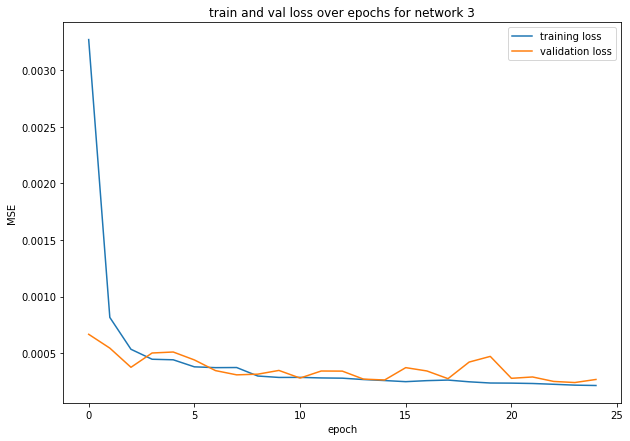

In [47]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.title('train and val loss over epochs for network 3')
plt.legend()



In [48]:
y_predict = predict(val_loader_r, model)

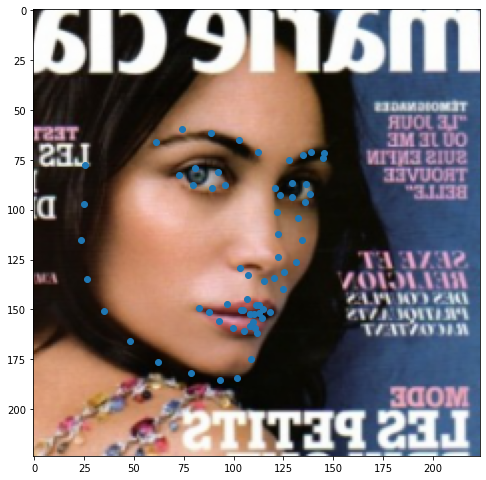

In [49]:
show_cropped_image_with_points_data_thing(val_dataset_r[69]['image'], y_predict[69])



### Model 4: same as model 3, with data augmentation

In [174]:
BATCH_SIZE = 4
NUM_EPOCHS = 25

train_loader_ra = DataLoader(train_dataset_ra, batch_size=BATCH_SIZE)
val_loader_ra = DataLoader(val_dataset_ra, batch_size=BATCH_SIZE)

In [175]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet34', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [177]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [ ]:
print(model)

In [180]:
train_loss_history = []
val_loss_history = []
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nn.MSELoss()

In [ ]:
for epoch in range(NUM_EPOCHS):
    train_loss = train(train_loader_ra, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

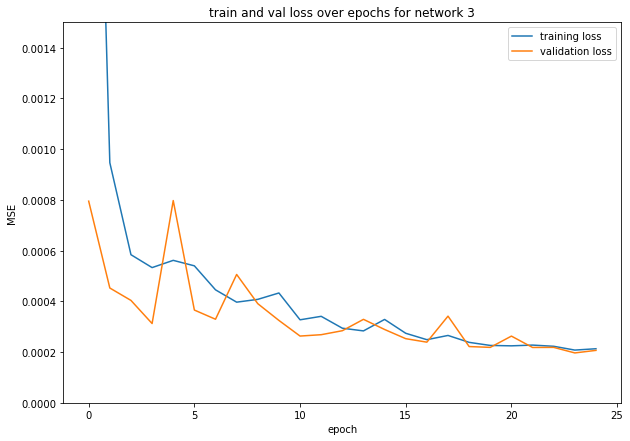

In [184]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0015)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.title('train and val loss over epochs for network 3')
plt.legend()



In [185]:
y_predict = predict(val_loader_ra, model)

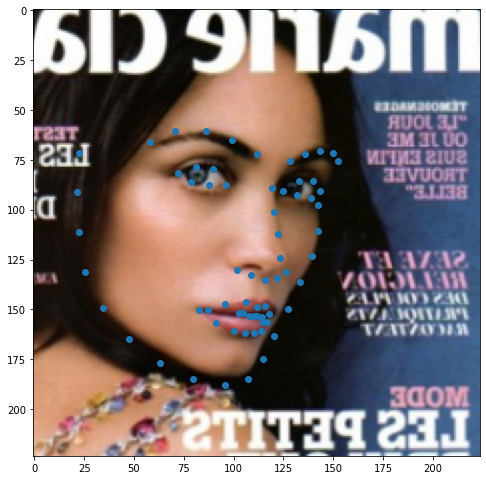

In [187]:
show_cropped_image_with_points_data_thing(val_dataset_ra[69]['image'], y_predict[69])

In [188]:
torch.save(model, 'models/model4_1.pt')

### Model 5: resnet 34 with 1e-4 optimizers

In [271]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet34', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [272]:
BATCH_SIZE = 4
NUM_EPOCHS = 30

train_loader_ra = DataLoader(train_dataset_ra, batch_size=BATCH_SIZE)
val_loader_ra = DataLoader(val_dataset_ra, batch_size=BATCH_SIZE)

In [273]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [274]:
train_loss_history = []
val_loss_history = []
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)


In [275]:
for epoch in range(NUM_EPOCHS):

    train_loss = train(train_loader_ra, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

training on 4866 samples


1217it [00:38, 31.33it/s]


validating on 1800 samples
epoch 0, train_loss 0.009136236065270911, val_loss 0.0015990787401743648
training on 4866 samples


1217it [00:38, 31.86it/s]


validating on 1800 samples
epoch 1, train_loss 0.001468461593165351, val_loss 0.000656246978453257
training on 4866 samples


1217it [00:38, 31.27it/s]


validating on 1800 samples
epoch 2, train_loss 0.0009250460979249405, val_loss 0.0004854722256358299
training on 4866 samples


1217it [00:38, 31.56it/s]


validating on 1800 samples
epoch 3, train_loss 0.0006209786372674796, val_loss 0.0003739854623563588
training on 4866 samples


1217it [00:38, 31.44it/s]


validating on 1800 samples
epoch 4, train_loss 0.00046134634380259047, val_loss 0.00034707537341293774
training on 4866 samples


1217it [00:38, 31.67it/s]


validating on 1800 samples
epoch 5, train_loss 0.0003778835705094248, val_loss 0.0002801580667599208
training on 4866 samples


1217it [00:38, 31.32it/s]


validating on 1800 samples
epoch 6, train_loss 0.0003565356306404169, val_loss 0.00032781869761594056
training on 4866 samples


1217it [00:38, 31.97it/s]


validating on 1800 samples
epoch 7, train_loss 0.0003106224375334817, val_loss 0.00035356431397505934
training on 4866 samples


1217it [00:37, 32.08it/s]


validating on 1800 samples
epoch 8, train_loss 0.0003116529637426536, val_loss 0.0002579842059316838
training on 4866 samples


1217it [00:38, 31.95it/s]


validating on 1800 samples
epoch 9, train_loss 0.000287218924125914, val_loss 0.00021819298875117157
training on 4866 samples


1217it [00:38, 31.36it/s]


validating on 1800 samples
epoch 10, train_loss 0.0002448042890083943, val_loss 0.0001981921779224649
training on 4866 samples


1217it [00:38, 31.93it/s]


validating on 1800 samples
epoch 11, train_loss 0.00023360389996530072, val_loss 0.00024202235566917808
training on 4866 samples


1217it [00:38, 31.47it/s]


validating on 1800 samples
epoch 12, train_loss 0.00022642389339945471, val_loss 0.00019131234450873712
training on 4866 samples


1217it [00:38, 31.48it/s]


validating on 1800 samples
epoch 13, train_loss 0.00022117238799049791, val_loss 0.00018626458123132276
training on 4866 samples


1217it [00:38, 31.59it/s]


validating on 1800 samples
epoch 14, train_loss 0.00020907897826917616, val_loss 0.0002567587069158132
training on 4866 samples


1217it [00:38, 31.22it/s]


validating on 1800 samples
epoch 15, train_loss 0.00021388150085263673, val_loss 0.00018378756228937872
training on 4866 samples


1217it [00:38, 31.71it/s]


validating on 1800 samples
epoch 16, train_loss 0.0002082294138785411, val_loss 0.00019787714367137393
training on 4866 samples


1217it [00:38, 31.67it/s]


validating on 1800 samples
epoch 17, train_loss 0.00019539431739485063, val_loss 0.0001803284409430085
training on 4866 samples


1217it [00:38, 31.80it/s]


validating on 1800 samples
epoch 18, train_loss 0.0001873804659265761, val_loss 0.00023569373164920965
training on 4866 samples


1217it [00:38, 31.67it/s]


validating on 1800 samples
epoch 19, train_loss 0.000184886765685868, val_loss 0.000233784445703754
training on 4866 samples


1217it [00:38, 31.68it/s]


validating on 1800 samples
epoch 20, train_loss 0.00017557305857264066, val_loss 0.00021732865991200216
training on 4866 samples


1217it [00:38, 31.78it/s]


validating on 1800 samples
epoch 21, train_loss 0.00018414263347833016, val_loss 0.00018415490317339492
training on 4866 samples


1217it [00:38, 31.51it/s]


validating on 1800 samples
epoch 22, train_loss 0.0001819618370802193, val_loss 0.00017492148388151288
training on 4866 samples


1217it [00:37, 32.13it/s]


validating on 1800 samples
epoch 23, train_loss 0.00016731793938700918, val_loss 0.00016553247106559056
training on 4866 samples


1217it [00:38, 31.54it/s]


validating on 1800 samples
epoch 24, train_loss 0.0001577583658941329, val_loss 0.0001693882351618312
training on 4866 samples


1217it [00:38, 31.96it/s]


validating on 1800 samples
epoch 25, train_loss 0.00016744695841317542, val_loss 0.0001962189319925124
training on 4866 samples


1217it [00:38, 31.39it/s]


validating on 1800 samples
epoch 26, train_loss 0.00017622781029821854, val_loss 0.00018155488814550658
training on 4866 samples


1217it [00:39, 31.17it/s]


validating on 1800 samples
epoch 27, train_loss 0.00016475091053885787, val_loss 0.00025461771480169977
training on 4866 samples


1217it [00:38, 31.54it/s]


validating on 1800 samples
epoch 28, train_loss 0.00015889926678402542, val_loss 0.00017980322882067413
training on 4866 samples


1217it [00:38, 31.25it/s]


validating on 1800 samples
epoch 29, train_loss 0.0001521240158393771, val_loss 0.00015812894751434213


In [278]:
val_dataset_ra_norm = KeypointsDataset224_aug(X_val, y_val, False, normalize=True)

In [279]:
val_loader_ra_norm = DataLoader(val_dataset_ra_norm, batch_size=BATCH_SIZE)

In [280]:
validate(val_loader_ra_norm, model, loss_fn)

0.0007346365560078993

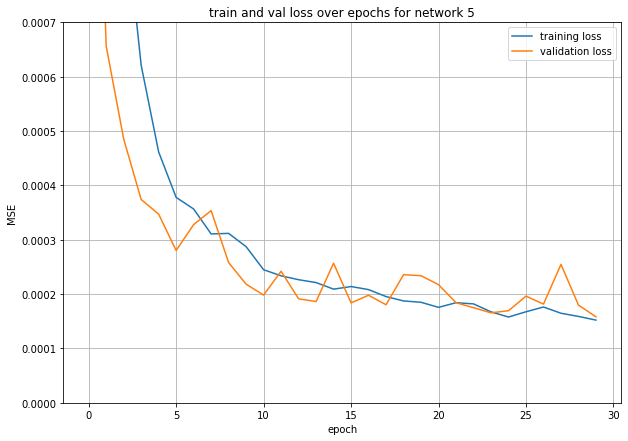

In [277]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0007)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for network 5')
plt.legend()



### resnet18 - 1e-4

In [255]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet18', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /home/jerry/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


In [256]:
BATCH_SIZE = 4
NUM_EPOCHS = 30

train_loader_ra = DataLoader(train_dataset_ra, batch_size=BATCH_SIZE)
val_loader_ra = DataLoader(val_dataset_ra, batch_size=BATCH_SIZE)

In [257]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [259]:
train_loss_history = []
val_loss_history = []
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)



In [260]:
for epoch in range(NUM_EPOCHS):

    train_loss = train(train_loader_ra, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

training on 4866 samples


1217it [00:28, 43.27it/s]


validating on 1800 samples
epoch 0, train_loss 0.016268147699647385, val_loss 0.0017967323526843553
training on 4866 samples


1217it [00:27, 43.60it/s]


validating on 1800 samples
epoch 1, train_loss 0.0017088233051712923, val_loss 0.000933341515612685
training on 4866 samples


1217it [00:27, 44.16it/s]


validating on 1800 samples
epoch 2, train_loss 0.0011398546562360595, val_loss 0.0005788563604518357
training on 4866 samples


1217it [00:28, 43.35it/s]


validating on 1800 samples
epoch 3, train_loss 0.0008349826854480325, val_loss 0.00042586607130942864
training on 4866 samples


1217it [00:27, 43.55it/s]


validating on 1800 samples
epoch 4, train_loss 0.0006462092421652945, val_loss 0.00036647571412484265
training on 4866 samples


1217it [00:27, 43.53it/s]


validating on 1800 samples
epoch 5, train_loss 0.0005065187248284641, val_loss 0.0003138399742440217
training on 4866 samples


1217it [00:27, 43.88it/s]


validating on 1800 samples
epoch 6, train_loss 0.00042997546777010176, val_loss 0.00030462746446978096
training on 4866 samples


1217it [00:28, 43.37it/s]


validating on 1800 samples
epoch 7, train_loss 0.0003808906981431678, val_loss 0.00025250866239528275
training on 4866 samples


1217it [00:27, 43.68it/s]


validating on 1800 samples
epoch 8, train_loss 0.00033834123099959346, val_loss 0.0002658598392089415
training on 4866 samples


1217it [00:27, 43.90it/s]


validating on 1800 samples
epoch 9, train_loss 0.0003136176349762207, val_loss 0.0002384507187202366
training on 4866 samples


1217it [00:28, 42.99it/s]


validating on 1800 samples
epoch 10, train_loss 0.0002970628709608464, val_loss 0.00021374135863475708
training on 4866 samples


1217it [00:27, 43.57it/s]


validating on 1800 samples
epoch 11, train_loss 0.00026375793697855425, val_loss 0.0002532627554481021
training on 4866 samples


1217it [00:28, 43.40it/s]


validating on 1800 samples
epoch 12, train_loss 0.00024403791422234432, val_loss 0.00020406942289102718
training on 4866 samples


1217it [00:27, 43.66it/s]


validating on 1800 samples
epoch 13, train_loss 0.00024139533950685122, val_loss 0.00019855060944488892
training on 4866 samples


1217it [00:27, 43.56it/s]


validating on 1800 samples
epoch 14, train_loss 0.00022828693401521675, val_loss 0.00020322110882261768
training on 4866 samples


1217it [00:27, 43.95it/s]


validating on 1800 samples
epoch 15, train_loss 0.00021413904357786293, val_loss 0.00020426278164248086
training on 4866 samples


1217it [00:27, 43.68it/s]


validating on 1800 samples
epoch 16, train_loss 0.00021513047839842825, val_loss 0.000196352560694019
training on 4866 samples


1217it [00:28, 43.43it/s]


validating on 1800 samples
epoch 17, train_loss 0.00020224450982407068, val_loss 0.00020978628572063625
training on 4866 samples


1217it [00:28, 43.43it/s]


validating on 1800 samples
epoch 18, train_loss 0.0001970386900632943, val_loss 0.00024161490666705908
training on 4866 samples


1217it [00:28, 42.95it/s]


validating on 1800 samples
epoch 19, train_loss 0.00018908705924847679, val_loss 0.0002465964053408243
training on 4866 samples


1217it [00:28, 42.82it/s]


validating on 1800 samples
epoch 20, train_loss 0.00019782774415869273, val_loss 0.000162468257137031
training on 4866 samples


1217it [00:27, 43.52it/s]


validating on 1800 samples
epoch 21, train_loss 0.0001912013284034412, val_loss 0.00017397117060479812
training on 4866 samples


1217it [00:27, 43.85it/s]


validating on 1800 samples
epoch 22, train_loss 0.0001772373731940833, val_loss 0.00018049211766790703
training on 4866 samples


1217it [00:28, 43.24it/s]


validating on 1800 samples
epoch 23, train_loss 0.00017730884687475141, val_loss 0.0002028899076685775
training on 4866 samples


1217it [00:28, 43.38it/s]


validating on 1800 samples
epoch 24, train_loss 0.00017261313428487606, val_loss 0.00023390015834593214
training on 4866 samples


1217it [00:28, 42.71it/s]


validating on 1800 samples
epoch 25, train_loss 0.00017215915224276713, val_loss 0.00017282975677517242
training on 4866 samples


1217it [00:28, 43.25it/s]


validating on 1800 samples
epoch 26, train_loss 0.00017716234866674147, val_loss 0.00017878807081918543
training on 4866 samples


1217it [00:27, 43.50it/s]


validating on 1800 samples
epoch 27, train_loss 0.00016155167322542906, val_loss 0.00020678526214194587
training on 4866 samples


1217it [00:28, 42.98it/s]


validating on 1800 samples
epoch 28, train_loss 0.00016007926849077856, val_loss 0.00017876112883742382
training on 4866 samples


1217it [00:28, 42.96it/s]


validating on 1800 samples
epoch 29, train_loss 0.000157751636858953, val_loss 0.00018324319640265053


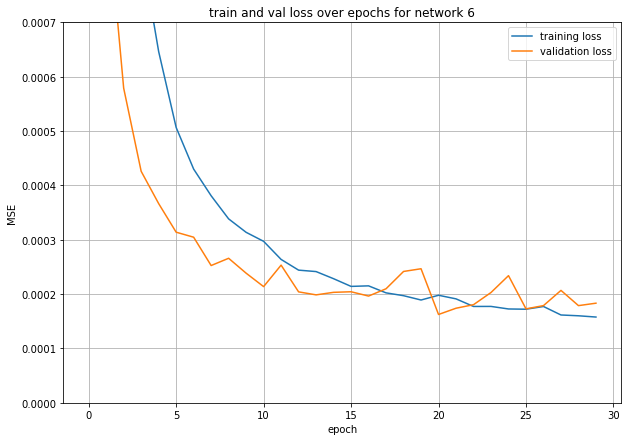

In [263]:

plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0007)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for network 6')
plt.legend()




### Model 7: efficientnet b2

In [13]:
model = torchvision.models.efficientnet_b2(pretrained=True, progress = False)

In [14]:
train_dataset_ra_norm = KeypointsDataset224_aug(X_train, y_train, True, img_size=288)
val_dataset_ra_norm = KeypointsDataset224_aug(X_val, y_val, False, img_size=288)

In [15]:
BATCH_SIZE = 4
NUM_EPOCHS = 30

train_loader_ra_norm = DataLoader(train_dataset_ra_norm, batch_size=BATCH_SIZE)
val_loader_ra_norm = DataLoader(val_dataset_ra_norm, batch_size=BATCH_SIZE)

In [16]:
lin = model.classifier[1]
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.classifier[1] = new_lin

model = model.to(device)

In [17]:
train_loss_history = []
val_loss_history = []
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)


In [18]:
for epoch in range(NUM_EPOCHS):

    train_loss = train(train_loader_ra_norm, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra_norm, model, loss_fn)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

epoch 0, train_loss 0.015753822796805872, val_loss 0.0021092625050288106
epoch 1, train_loss 0.0031393358389018204, val_loss 0.0014373443725829323
epoch 2, train_loss 0.002082709451127589, val_loss 0.0009332156484015286
epoch 3, train_loss 0.0014946502478666614, val_loss 0.0005947061265922255
epoch 4, train_loss 0.0012028255647594751, val_loss 0.0004575689780176617
epoch 5, train_loss 0.0009710979016594154, val_loss 0.00034717283295726195
epoch 6, train_loss 0.0008450456997383486, val_loss 0.0004015997013064205
epoch 7, train_loss 0.0007623203179413329, val_loss 0.00030771129522084566
epoch 8, train_loss 0.0006675521773353124, val_loss 0.0002684945904022445
epoch 9, train_loss 0.0006270271404136482, val_loss 0.00023989929151462598
epoch 10, train_loss 0.0005876288380206585, val_loss 0.00026059372554300354
epoch 11, train_loss 0.0005502861868222791, val_loss 0.00021849119052704837
epoch 12, train_loss 0.0005095242026433021, val_loss 0.00027119747039655015
epoch 13, train_loss 0.00050271

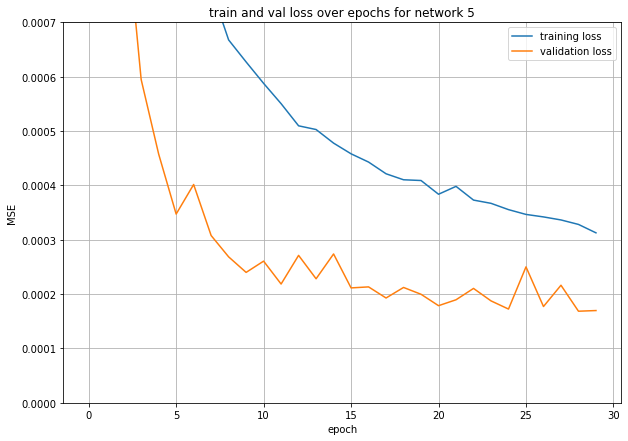

In [19]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0007)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for network 5')
plt.legend()



In [20]:
torch.save(model, 'models/efficientnet_b2.pt')

### mobilenet v3 large

In [13]:
model = torchvision.models.mobilenet_v3_large(pretrained=True, progress = False)

In [14]:
train_dataset_ra = KeypointsDataset224_aug(X_train, y_train, True)
val_dataset_ra = KeypointsDataset224_aug(X_val, y_val, False)

In [15]:
BATCH_SIZE = 4
NUM_EPOCHS = 30

train_loader_ra_norm = DataLoader(train_dataset_ra_norm, batch_size=BATCH_SIZE)
val_loader_ra_norm = DataLoader(val_dataset_ra_norm, batch_size=BATCH_SIZE)

In [16]:
lin = model.classifier[3]
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.classifier[3] = new_lin

model = model.to(device)

In [18]:
LR = 1e-3
train_loss_history = []
val_loss_history = []
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)


In [19]:
for epoch in range(NUM_EPOCHS):

    train_loss = train(train_loader_ra_norm, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra_norm, model, loss_fn)
    
    LR = 0.9047 * LR
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

1217it [00:54, 22.16it/s]


epoch 0, train_loss 0.008942806351581326, val_loss 0.0016485380923323748


1217it [00:49, 24.55it/s]


epoch 1, train_loss 0.001892302367716091, val_loss 0.0011494960560230539


1217it [00:49, 24.62it/s]


epoch 2, train_loss 0.0013500276059348476, val_loss 0.001205649036500189


1217it [00:49, 24.50it/s]


epoch 3, train_loss 0.0011898318200436059, val_loss 0.0009047712073273335


1217it [00:51, 23.82it/s]


epoch 4, train_loss 0.001079406364163347, val_loss 0.0008755597436619509


1217it [00:52, 23.26it/s]


epoch 5, train_loss 0.0009994527346604935, val_loss 0.0009492957910212377


1217it [00:51, 23.60it/s]


epoch 6, train_loss 0.000964598860253022, val_loss 0.0009387700614105496


1217it [00:53, 22.89it/s]


epoch 7, train_loss 0.0009356014461707302, val_loss 0.0008866137424613246


1217it [00:53, 22.75it/s]


epoch 8, train_loss 0.0009023038849396051, val_loss 0.0008345729581520168


1217it [00:52, 23.14it/s]


epoch 9, train_loss 0.000890190495510418, val_loss 0.000793370287412674


1217it [00:52, 23.09it/s]


epoch 10, train_loss 0.0008611271607260248, val_loss 0.0007851664028324497


1217it [00:50, 24.23it/s]


epoch 11, train_loss 0.0008420327506808682, val_loss 0.0007287911002317236


1217it [00:50, 24.18it/s]


epoch 12, train_loss 0.0008387285402691682, val_loss 0.0007132975707645528


1217it [00:50, 23.99it/s]


epoch 13, train_loss 0.0008210669270308724, val_loss 0.000729807969635456


1217it [00:50, 24.12it/s]


epoch 14, train_loss 0.0008065861300493559, val_loss 0.0007138509240919828


1217it [00:50, 23.89it/s]


epoch 15, train_loss 0.0006547833107550182, val_loss 0.00037583935918519276


1217it [00:50, 24.14it/s]


epoch 16, train_loss 0.00043552475787468495, val_loss 0.0003926360731970312


1217it [00:50, 23.93it/s]


epoch 17, train_loss 0.0004087906773981731, val_loss 0.0003709735462325625


1217it [00:50, 24.13it/s]


epoch 18, train_loss 0.00039662761081535455, val_loss 0.00034871841861685324


1217it [00:50, 24.06it/s]


epoch 19, train_loss 0.0003886355101677108, val_loss 0.0003429475020513766


1217it [00:51, 23.82it/s]


epoch 20, train_loss 0.0003836185878320446, val_loss 0.0003608578740062916


1217it [00:50, 23.93it/s]


epoch 21, train_loss 0.00037801796012497206, val_loss 0.0003329659505915414


1217it [00:51, 23.69it/s]


epoch 22, train_loss 0.0003695866561187898, val_loss 0.0003477751838120942


1217it [00:50, 24.24it/s]


epoch 23, train_loss 0.0003656832597882509, val_loss 0.0003299306680694119


1217it [00:49, 24.76it/s]


epoch 24, train_loss 0.0003557654864061203, val_loss 0.0003196444107258382


1217it [00:48, 25.13it/s]


epoch 25, train_loss 0.00032807700504576017, val_loss 0.0002680469027513431


1217it [00:46, 26.22it/s]


epoch 26, train_loss 0.000297102153036937, val_loss 0.00024978172614484925


1217it [00:46, 26.11it/s]


epoch 27, train_loss 0.0002861021164845447, val_loss 0.00026189382165385825


1217it [00:46, 26.04it/s]


epoch 28, train_loss 0.0002790620652292974, val_loss 0.0002410403319906133


1217it [00:47, 25.78it/s]


epoch 29, train_loss 0.00027320599577908316, val_loss 0.00023840684412991525


In [20]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

for epoch in range(30, 37):

    train_loss = train(train_loader_ra_norm, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra_norm, model, loss_fn)
    
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

1217it [00:48, 25.27it/s]


epoch 30, train_loss 0.0002787879979135178, val_loss 0.0002456329481598611


1217it [00:47, 25.54it/s]


epoch 31, train_loss 0.00027422618068823166, val_loss 0.00025520524010062216


1217it [00:47, 25.52it/s]


epoch 32, train_loss 0.0002710364949613987, val_loss 0.0002511271895976582


1217it [00:47, 25.40it/s]


epoch 33, train_loss 0.00026898914926941564, val_loss 0.00028499225969426335


1217it [00:47, 25.84it/s]


epoch 34, train_loss 0.00026667009968041414, val_loss 0.00024083493204670958


1217it [00:47, 25.57it/s]


epoch 35, train_loss 0.0002639558890489318, val_loss 0.00024202970896213728


1217it [00:47, 25.74it/s]


epoch 36, train_loss 0.00026347232603018603, val_loss 0.00024387824556065932


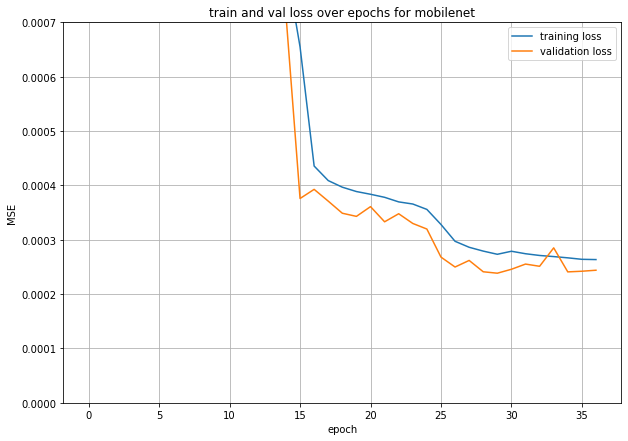

In [21]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0007)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for mobilenet')
plt.legend()



In [22]:
torch.save(model, 'models/mobilenet.pt')

### Model 9: back to resnet34, with decaying LR 1e-3 to 5e-5

In [15]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet34', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [16]:
BATCH_SIZE = 4
NUM_EPOCHS = 30

train_loader_ra = DataLoader(train_dataset_ra, batch_size=BATCH_SIZE)
val_loader_ra = DataLoader(val_dataset_ra, batch_size=BATCH_SIZE)

In [17]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [18]:
LR = 1e-3
train_loss_history = []
val_loss_history = []
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)


old aug: .00014 val acc

In [19]:
for epoch in range(NUM_EPOCHS):

    train_loss = train(train_loader_ra, model, loss_fn, optimizer)
    
    val_loss = validate(val_loader_ra, model, loss_fn)
    
    LR = max(5e-5, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")

1217it [00:50, 24.10it/s]


epoch 0, train_loss 0.005670209095473558, val_loss 0.0012125246375540477


1217it [00:50, 23.99it/s]


epoch 1, train_loss 0.002191927305525268, val_loss 0.0011465524644073512


1217it [00:50, 24.05it/s]


epoch 2, train_loss 0.0011252330417339993, val_loss 0.0005397941525896184


1217it [00:50, 24.14it/s]


epoch 3, train_loss 0.0007621350366910713, val_loss 0.00045430053817755025


1217it [00:50, 24.23it/s]


epoch 4, train_loss 0.0005379515691815692, val_loss 0.0003765485127223656


1217it [00:50, 23.96it/s]


epoch 5, train_loss 0.0004932081909684178, val_loss 0.0003244315330327178


1217it [00:50, 24.10it/s]


epoch 6, train_loss 0.00042251220716993057, val_loss 0.00033733998929771285


1217it [00:50, 24.04it/s]


epoch 7, train_loss 0.00037911845509926335, val_loss 0.0002945772225050152


1217it [00:51, 23.84it/s]


epoch 8, train_loss 0.00032038730368302826, val_loss 0.000340115998891027


1217it [00:50, 24.11it/s]


epoch 9, train_loss 0.00029473347445791505, val_loss 0.0002425229957508337


1217it [00:49, 24.35it/s]


epoch 10, train_loss 0.00027816180540370236, val_loss 0.00020599425142993116


1217it [00:50, 24.00it/s]


epoch 11, train_loss 0.0002578163890043429, val_loss 0.00020661070701963682


1217it [00:50, 24.08it/s]


epoch 12, train_loss 0.00024332282791261796, val_loss 0.00020114458917911784


1217it [00:50, 23.87it/s]


epoch 13, train_loss 0.0002305359687679983, val_loss 0.00021417587242063342


1217it [00:50, 24.14it/s]


epoch 14, train_loss 0.0002141151090073931, val_loss 0.00017607979012407467


1217it [00:50, 24.07it/s]


epoch 15, train_loss 0.00020823996897334203, val_loss 0.00020489850671664397


1217it [00:50, 24.13it/s]


epoch 16, train_loss 0.0001968430446568171, val_loss 0.00019050335682954434


1217it [00:50, 24.09it/s]


epoch 17, train_loss 0.0001888749551176952, val_loss 0.00017560859786398296


1217it [00:50, 23.86it/s]


epoch 18, train_loss 0.00018336968206360114, val_loss 0.00018268338187934003


1217it [00:50, 24.07it/s]


epoch 19, train_loss 0.0001780395561362113, val_loss 0.00016236514913746053


1217it [00:50, 23.95it/s]


epoch 20, train_loss 0.00016869377034820383, val_loss 0.00015622588463075872


1217it [00:50, 24.16it/s]


epoch 21, train_loss 0.00016674185578746534, val_loss 0.00017052986279142917


1217it [00:50, 24.08it/s]


epoch 22, train_loss 0.00016447746032233302, val_loss 0.0001513165592688084


1217it [00:50, 24.11it/s]


epoch 23, train_loss 0.00015606244898480788, val_loss 0.00015278611416255847


1217it [00:51, 23.83it/s]


epoch 24, train_loss 0.00015218468938629705, val_loss 0.00015259766923716395


1217it [00:50, 24.08it/s]


epoch 25, train_loss 0.00014971448156860984, val_loss 0.0001495476465626982


1217it [00:51, 23.77it/s]


epoch 26, train_loss 0.00014676966659899575, val_loss 0.00014249119973909626


1217it [00:51, 23.82it/s]


epoch 27, train_loss 0.00014522931039285132, val_loss 0.00014264422117978232


1217it [00:50, 23.89it/s]


epoch 28, train_loss 0.00014195226188123953, val_loss 0.00014270136635685857


1217it [00:51, 23.64it/s]


epoch 29, train_loss 0.0001408811636679368, val_loss 0.00014021903971701653


In [30]:
torch.save(model, 'model9_moreaug.pt')

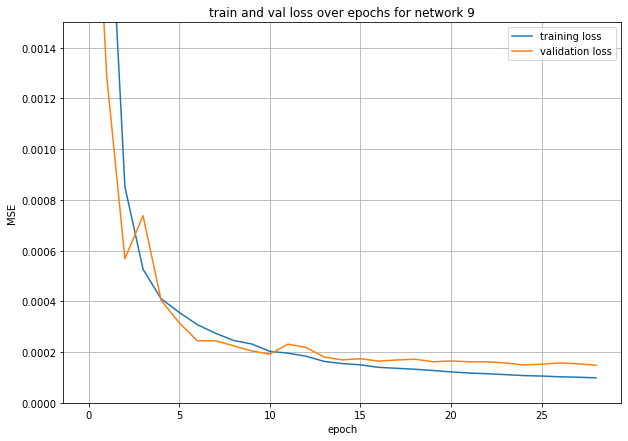

In [51]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0015)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for network 9')
plt.legend()


### Training preferred model on ALL the data

I shall decide to go with:
- Resnet34
- Yes pretrained
- Yes random data augmentation
- No normalization
- Adam with decaying LR 1e-3 -> 5e-5

In [11]:
BATCH_SIZE = 4
NUM_EPOCHS = 65


In [12]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet34', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [13]:
X_nosplit, X_smallval, y_nosplit, y_smallval = train_test_split(X_all, y_all, test_size=80, random_state=69, shuffle = True)

In [14]:
del X_all
del y_all

In [15]:
nosplit_dataset_ra = KeypointsDataset224_aug(X_nosplit, y_nosplit, True)
smallval_dataset_ra = KeypointsDataset224_aug(X_smallval, y_smallval, False)

nosplit_loader = DataLoader(nosplit_dataset_ra, batch_size=BATCH_SIZE)
smallval_loader = DataLoader(smallval_dataset_ra, batch_size=BATCH_SIZE)

In [16]:
len(nosplit_dataset_ra), len(smallval_dataset_ra)

(6586, 80)

In [17]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [ ]:
LR = 1e-3
train_loss_history = []
val_loss_history = []

loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(NUM_EPOCHS):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(5e-5, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if epoch%5 == 0 and epoch > 20:
        torch.save(model, f"model_final2_epoch{epoch}.pt")
        
torch.save(model, f"model_final2_epoch{epoch}.pt")

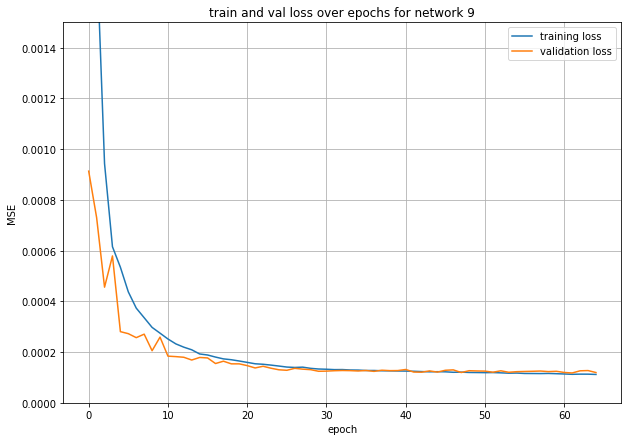

In [19]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0015)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for network 9')
plt.legend()


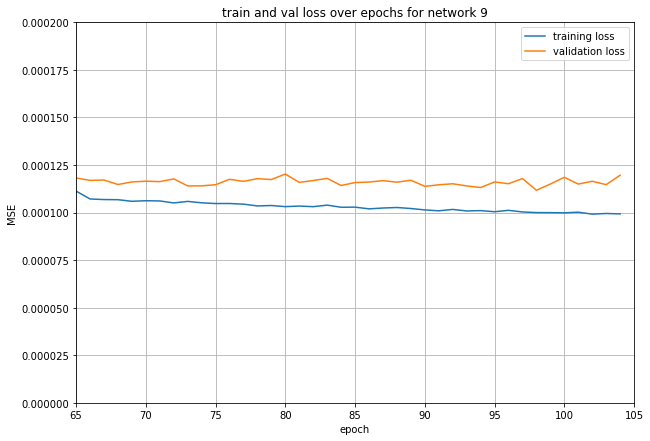

In [32]:
plt.figure(figsize = (10, 7))
plt.plot(range(len(train_loss_history)), train_loss_history, label = 'training loss')
plt.plot(range(len(val_loss_history)), val_loss_history, label = 'validation loss')
plt.ylim(0, 0.0002)
plt.xlim(65, 105)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.grid()
plt.title('train and val loss over epochs for network 9')
plt.legend()


### Retrain for MAE instead of MSE

In [17]:
model = torch.load('model_final3_epoch59.pt').to(device)

In [12]:
BATCH_SIZE = 4
NUM_EPOCHS = 65


In [13]:
X_nosplit, X_smallval, y_nosplit, y_smallval = train_test_split(X_all, y_all, test_size=80, random_state=69, shuffle = True)

del X_all
del y_all

In [14]:
nosplit_dataset_ra = KeypointsDataset224_aug(X_nosplit, y_nosplit, False)
smallval_dataset_ra = KeypointsDataset224_aug(X_smallval, y_smallval, False)

nosplit_loader = DataLoader(nosplit_dataset_ra, batch_size=BATCH_SIZE)
smallval_loader = DataLoader(smallval_dataset_ra, batch_size=BATCH_SIZE)

In [15]:
len(nosplit_dataset_ra), len(smallval_dataset_ra)

(6586, 80)

In [18]:
LR = 1e-5
train_loss_history = []
val_loss_history = []

loss_fn = nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(NUM_EPOCHS):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(1e-6, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if epoch%5 == 0 and epoch > 0:
        torch.save(model, f"model_final6_epoch{epoch}.pt")
        
torch.save(model, f"model_final6_epoch{epoch}.pt")

1647it [00:40, 40.40it/s]


epoch 0, train_loss 0.00610969383094254, val_loss 0.00719117249827832


1647it [00:41, 40.01it/s]


epoch 1, train_loss 0.006028639143598608, val_loss 0.007185599231161177


1647it [00:40, 40.57it/s]


epoch 2, train_loss 0.0059710326381186025, val_loss 0.00717914781998843


1647it [00:40, 40.22it/s]


epoch 3, train_loss 0.005924873234128492, val_loss 0.007176214247010648


1647it [00:41, 39.74it/s]


epoch 4, train_loss 0.005886525679357083, val_loss 0.007172894105315209


1647it [00:40, 40.66it/s]


epoch 5, train_loss 0.0058533142775446445, val_loss 0.007179985428228975


1647it [00:41, 40.05it/s]


epoch 6, train_loss 0.00582419889461663, val_loss 0.007187140034511685


1647it [00:40, 40.92it/s]


epoch 7, train_loss 0.005799578590138742, val_loss 0.007188433385454118


1647it [00:40, 40.46it/s]


epoch 8, train_loss 0.00577750185682112, val_loss 0.007198540726676583


1647it [00:40, 40.27it/s]


epoch 9, train_loss 0.005757726920326424, val_loss 0.007210000045597553


1647it [00:41, 39.43it/s]


epoch 10, train_loss 0.005739960372764629, val_loss 0.0072211402002722025


1647it [00:40, 40.43it/s]


epoch 11, train_loss 0.005724071795895524, val_loss 0.007221009605564177


1647it [00:40, 40.46it/s]


epoch 12, train_loss 0.005710038775776054, val_loss 0.007228596764616668


1647it [00:40, 40.41it/s]


epoch 13, train_loss 0.005697421770278222, val_loss 0.007227661646902561


1647it [00:40, 40.70it/s]


epoch 14, train_loss 0.00568641576255515, val_loss 0.007227530260570348


1647it [00:40, 40.57it/s]


epoch 15, train_loss 0.005676769568914526, val_loss 0.007223340426571667


1647it [00:41, 39.97it/s]


epoch 16, train_loss 0.005667775662974401, val_loss 0.007216613739728928


1647it [00:40, 40.23it/s]


epoch 17, train_loss 0.005659537650837038, val_loss 0.00721097425557673


1647it [00:40, 40.53it/s]


epoch 18, train_loss 0.005652428871279658, val_loss 0.007201518188230694


1647it [00:40, 40.24it/s]


epoch 19, train_loss 0.005645931262124848, val_loss 0.00719941093120724


1647it [00:40, 40.28it/s]


epoch 20, train_loss 0.005640389459941629, val_loss 0.0071925643598660825


1647it [00:40, 40.35it/s]


epoch 21, train_loss 0.005635122453333594, val_loss 0.0071849863743409514


1647it [00:41, 40.10it/s]


epoch 22, train_loss 0.0056304591572173416, val_loss 0.007181052025407553


1647it [00:40, 40.59it/s]


epoch 23, train_loss 0.005626449328929222, val_loss 0.007177736144512892


1647it [00:40, 40.33it/s]


epoch 24, train_loss 0.005622682337206406, val_loss 0.007181469234637916


1647it [00:40, 40.39it/s]


epoch 25, train_loss 0.005618997850654953, val_loss 0.007179050683043897


1647it [00:40, 41.02it/s]


epoch 26, train_loss 0.005615401723544816, val_loss 0.00717282339464873


1647it [00:39, 41.96it/s]


epoch 27, train_loss 0.0056118364242297375, val_loss 0.007176043279469013


1647it [00:40, 40.87it/s]


epoch 28, train_loss 0.005608206856871419, val_loss 0.007176126702688634


1647it [00:39, 41.52it/s]


epoch 29, train_loss 0.005604630908699798, val_loss 0.007177292718552053


1647it [00:39, 41.90it/s]


epoch 30, train_loss 0.005601463754026363, val_loss 0.0071771985851228235


1647it [00:42, 38.60it/s]


epoch 31, train_loss 0.005597904923077363, val_loss 0.007177058537490666


1647it [00:41, 39.44it/s]


epoch 32, train_loss 0.00559449287325949, val_loss 0.007178333564661443


1647it [00:41, 39.51it/s]


epoch 33, train_loss 0.005591075956192643, val_loss 0.007178520993329584


1647it [00:41, 39.64it/s]


epoch 34, train_loss 0.005587740148444228, val_loss 0.007177943247370422


1647it [00:41, 40.07it/s]


epoch 35, train_loss 0.005584465804027476, val_loss 0.007180879102088511


1647it [00:41, 39.91it/s]


epoch 36, train_loss 0.005581040535027158, val_loss 0.007178521645255387


1647it [00:41, 39.81it/s]


epoch 37, train_loss 0.005577946163467389, val_loss 0.007181306625716389


1647it [00:41, 39.56it/s]


epoch 38, train_loss 0.005574644731247993, val_loss 0.007184714800678194


1647it [00:41, 39.66it/s]


epoch 39, train_loss 0.005571572532460012, val_loss 0.00718226027674973


1647it [00:41, 39.83it/s]


epoch 40, train_loss 0.005568424993803647, val_loss 0.007183688320219516


1647it [00:41, 39.53it/s]


epoch 41, train_loss 0.005565113453878713, val_loss 0.007185623329132795


1647it [00:42, 38.87it/s]


epoch 42, train_loss 0.005561816079160916, val_loss 0.0071823162259534


1647it [00:41, 39.94it/s]


epoch 43, train_loss 0.005558519903513867, val_loss 0.007184137101285159


1647it [00:42, 38.37it/s]


epoch 44, train_loss 0.00555565713581917, val_loss 0.007184697268530727


1647it [00:43, 37.82it/s]


epoch 45, train_loss 0.0055525311148421795, val_loss 0.007187853311188519


1647it [00:41, 39.47it/s]


epoch 46, train_loss 0.005549600315079518, val_loss 0.007186075812205673


1647it [00:40, 40.80it/s]


epoch 47, train_loss 0.005546516067623803, val_loss 0.007186573348008096


1647it [00:40, 41.05it/s]


epoch 48, train_loss 0.005543305914912375, val_loss 0.007182600256055593


1647it [00:39, 41.22it/s]


epoch 49, train_loss 0.005540214957071114, val_loss 0.00718697183765471


1647it [00:39, 41.25it/s]


epoch 50, train_loss 0.005537255026759726, val_loss 0.00718662366271019


1647it [00:40, 40.58it/s]


epoch 51, train_loss 0.005533966796617428, val_loss 0.007186126359738409


1647it [00:43, 37.74it/s]


epoch 52, train_loss 0.005530997078937015, val_loss 0.007184391166083515


1647it [00:40, 40.72it/s]


epoch 53, train_loss 0.005527992808453978, val_loss 0.007187139801681041


1647it [00:41, 39.90it/s]


epoch 54, train_loss 0.005525032118721692, val_loss 0.007182151707820594


1647it [00:40, 40.95it/s]


epoch 55, train_loss 0.005522253789244028, val_loss 0.007185549708083272


1647it [00:41, 40.15it/s]


epoch 56, train_loss 0.005519395782349322, val_loss 0.007185425842180848


1647it [00:41, 40.03it/s]


epoch 57, train_loss 0.005516276726641697, val_loss 0.007185003231279552


1647it [00:40, 40.18it/s]


epoch 58, train_loss 0.005513500385766743, val_loss 0.007188766612671316


1647it [00:40, 40.43it/s]


epoch 59, train_loss 0.005510601714653776, val_loss 0.007194040529429913


1647it [00:41, 39.99it/s]


epoch 60, train_loss 0.005507659134254285, val_loss 0.007190718874335289


1647it [00:40, 40.46it/s]


epoch 61, train_loss 0.005504887973755128, val_loss 0.00719044441357255


1647it [00:40, 40.31it/s]


epoch 62, train_loss 0.005501954019398773, val_loss 0.007188686681911349


1647it [00:40, 40.59it/s]


epoch 63, train_loss 0.005499176886729991, val_loss 0.007190003897994757


1647it [00:41, 39.95it/s]


epoch 64, train_loss 0.005496352131359175, val_loss 0.007194376620464027


In [15]:
model = torch.load('model_final3_epoch20.pt').to(device)

In [16]:
LR = 1e-5
train_loss_history = []
val_loss_history = []

best_val_loss = 1
loss_fn = nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(20, 65):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(1e-6, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if val_loss < best_val_loss - 0.0001:
        torch.save(model, f"model_final3_epoch{epoch}.pt")
        best_val_loss = val_loss
torch.save(model, f"model_final3_epoch{epoch}.pt")

1647it [01:10, 23.26it/s]


epoch 20, train_loss 0.007031874005690117, val_loss 0.007261686050333083


1647it [01:10, 23.35it/s]


epoch 21, train_loss 0.007003002863379595, val_loss 0.007250589318573475


1647it [01:10, 23.45it/s]


epoch 22, train_loss 0.006977825845141047, val_loss 0.0072009039111435415


1647it [01:10, 23.35it/s]


epoch 23, train_loss 0.006954606640835151, val_loss 0.007276353682391346


1647it [01:13, 22.32it/s]


epoch 24, train_loss 0.006955065780037106, val_loss 0.007274855836294591


1647it [01:12, 22.82it/s]


epoch 25, train_loss 0.006948165644444277, val_loss 0.007316670496948063


1647it [01:10, 23.42it/s]


epoch 26, train_loss 0.006934540004723349, val_loss 0.007277148216962815


1647it [01:10, 23.33it/s]


epoch 27, train_loss 0.006923421287177437, val_loss 0.0073058572597801685


1647it [01:10, 23.44it/s]


epoch 28, train_loss 0.006928822238271933, val_loss 0.00726313148625195


1647it [01:10, 23.41it/s]


epoch 29, train_loss 0.006910757315483648, val_loss 0.007234755787067115


1647it [01:10, 23.39it/s]


epoch 30, train_loss 0.006891662203472132, val_loss 0.007223463268019259


1647it [01:10, 23.22it/s]


epoch 31, train_loss 0.006892353129184691, val_loss 0.007263141521252692


1647it [01:10, 23.20it/s]


epoch 32, train_loss 0.006889282546498664, val_loss 0.007267520320601762


1647it [01:10, 23.38it/s]


epoch 33, train_loss 0.006882054408934164, val_loss 0.007238768180832267


1647it [01:10, 23.51it/s]


epoch 34, train_loss 0.006882931419626177, val_loss 0.007247154135257006


1647it [01:10, 23.31it/s]


epoch 35, train_loss 0.006876784711555959, val_loss 0.007236293610185384


1647it [01:10, 23.33it/s]


epoch 36, train_loss 0.006876852368437202, val_loss 0.007218071329407394


1647it [01:10, 23.25it/s]


epoch 37, train_loss 0.006878398965849668, val_loss 0.007181006181053817


1647it [01:11, 23.12it/s]


epoch 38, train_loss 0.006878334743609176, val_loss 0.0071977080777287485


1647it [01:10, 23.27it/s]


epoch 39, train_loss 0.0068656545402125905, val_loss 0.007171187316998839


1647it [01:11, 23.11it/s]


epoch 40, train_loss 0.006854041908433944, val_loss 0.007193407160229981


1647it [01:10, 23.25it/s]


epoch 41, train_loss 0.006868007992075911, val_loss 0.007180755888111889


1647it [01:10, 23.35it/s]


epoch 42, train_loss 0.006887804388006981, val_loss 0.007203130074776709


1647it [01:11, 23.19it/s]


epoch 43, train_loss 0.006886394693316585, val_loss 0.007249799789860845


1647it [01:13, 22.53it/s]


epoch 44, train_loss 0.006862955124065977, val_loss 0.0071846573846414685


1647it [01:11, 23.03it/s]


epoch 45, train_loss 0.006869368961688219, val_loss 0.007169544696807861


1647it [01:08, 23.88it/s]


epoch 46, train_loss 0.006875233615012913, val_loss 0.0071896743029356


1647it [01:09, 23.83it/s]


epoch 47, train_loss 0.006863409292255938, val_loss 0.007179412990808487


1647it [01:09, 23.69it/s]


epoch 48, train_loss 0.006856816232150152, val_loss 0.0072321882238611575


1647it [01:09, 23.76it/s]


epoch 49, train_loss 0.006879836027965664, val_loss 0.007180303963832557


1647it [01:09, 23.64it/s]


epoch 50, train_loss 0.00685737118872508, val_loss 0.0072004592278972265


1647it [01:09, 23.65it/s]


epoch 51, train_loss 0.006848363580129041, val_loss 0.0071634223451837896


1647it [01:09, 23.63it/s]


epoch 52, train_loss 0.006854858647796716, val_loss 0.007170589431189001


1647it [01:09, 23.63it/s]


epoch 53, train_loss 0.00685484791807853, val_loss 0.0072237308602780105


1647it [01:09, 23.70it/s]


epoch 54, train_loss 0.006841193009269693, val_loss 0.007186999870464205


1647it [01:09, 23.85it/s]


epoch 55, train_loss 0.006848979018952044, val_loss 0.007190195634029806


1647it [01:08, 23.88it/s]


epoch 56, train_loss 0.006864069372643991, val_loss 0.007204865640960634


1647it [01:10, 23.50it/s]


epoch 57, train_loss 0.006861752361957149, val_loss 0.007200009375810623


1647it [01:09, 23.84it/s]


epoch 58, train_loss 0.006857262065653357, val_loss 0.0072139719733968375


1647it [01:09, 23.61it/s]


epoch 59, train_loss 0.006858270415729765, val_loss 0.007146682031452656


1647it [01:08, 23.98it/s]


epoch 60, train_loss 0.006865696923588994, val_loss 0.007218203437514603


1647it [01:10, 23.51it/s]


epoch 61, train_loss 0.00685259012158216, val_loss 0.007207523193210363


1647it [01:09, 23.85it/s]


epoch 62, train_loss 0.006861213155307948, val_loss 0.007196770934388042


1647it [01:10, 23.34it/s]


epoch 63, train_loss 0.0068536359312393914, val_loss 0.007214027736335993


1647it [01:09, 23.55it/s]


epoch 64, train_loss 0.006850271799296828, val_loss 0.007178492308594286


In [17]:
for epoch in range(65, 105):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(5e-7, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if val_loss < best_val_loss - 0.0001:
        torch.save(model, f"model_final3_epoch{epoch}.pt")
        best_val_loss = val_loss
torch.save(model, f"model_final3_epoch{epoch}.pt")

1647it [01:11, 23.02it/s]


epoch 65, train_loss 0.006841474164924208, val_loss 0.00715646306052804


1647it [01:10, 23.27it/s]


epoch 66, train_loss 0.006841038374097947, val_loss 0.007174401381053031


1647it [01:10, 23.24it/s]


epoch 67, train_loss 0.006869546579661863, val_loss 0.007194087281823159


1647it [01:10, 23.31it/s]


epoch 68, train_loss 0.006858043566868659, val_loss 0.007173340488225222


1647it [01:10, 23.30it/s]


epoch 69, train_loss 0.006853411293915984, val_loss 0.007186115253716707


1647it [01:10, 23.28it/s]


epoch 70, train_loss 0.006838728699484827, val_loss 0.007175820088014007


1647it [01:10, 23.31it/s]


epoch 71, train_loss 0.006844811783577629, val_loss 0.007193171139806509


1647it [01:10, 23.28it/s]


epoch 72, train_loss 0.006856197174344467, val_loss 0.007187441294081509


1647it [01:10, 23.52it/s]


epoch 73, train_loss 0.006835088098470323, val_loss 0.00718641395214945


1647it [01:11, 23.14it/s]


epoch 74, train_loss 0.006854807656613457, val_loss 0.00716589221265167


1647it [01:10, 23.35it/s]


epoch 75, train_loss 0.006824859933114515, val_loss 0.007197083532810211


1647it [01:10, 23.24it/s]


epoch 76, train_loss 0.00684119322782232, val_loss 0.007167762634344399


1647it [01:10, 23.22it/s]


epoch 77, train_loss 0.006862395018922718, val_loss 0.007151775271631777


1647it [01:11, 23.05it/s]


epoch 78, train_loss 0.006829274873999606, val_loss 0.007170407706871629


1647it [01:11, 23.01it/s]


epoch 79, train_loss 0.006857180020771355, val_loss 0.007207246613688767


1647it [01:11, 23.14it/s]


epoch 80, train_loss 0.006840434378328545, val_loss 0.0071833306457847355


1647it [01:10, 23.23it/s]


epoch 81, train_loss 0.006832582144655907, val_loss 0.007169368956238031


1647it [01:10, 23.49it/s]


epoch 82, train_loss 0.006832631797098306, val_loss 0.007189034763723612


1647it [01:09, 23.64it/s]


epoch 83, train_loss 0.006845734110718415, val_loss 0.007162105967290699


1647it [01:10, 23.37it/s]


epoch 84, train_loss 0.006836737746414663, val_loss 0.007141993776895106


1647it [01:10, 23.26it/s]


epoch 85, train_loss 0.006848518193813078, val_loss 0.0071820859797298905


1647it [01:10, 23.33it/s]


epoch 86, train_loss 0.006845269661790306, val_loss 0.007177979149855673


1647it [01:11, 23.08it/s]


epoch 87, train_loss 0.006847721546872519, val_loss 0.007216913742013276


1647it [01:11, 23.11it/s]


epoch 88, train_loss 0.006851296127181779, val_loss 0.0071539860451594


1647it [01:10, 23.33it/s]


epoch 89, train_loss 0.006850631492530207, val_loss 0.007167006144300103


1647it [01:10, 23.41it/s]


epoch 90, train_loss 0.006848797742695829, val_loss 0.007175400736741722


1647it [01:09, 23.67it/s]


epoch 91, train_loss 0.006834847736667161, val_loss 0.007159383036196232


1647it [01:09, 23.84it/s]


epoch 92, train_loss 0.006834427451202561, val_loss 0.007181528955698013


1647it [01:09, 23.76it/s]


epoch 93, train_loss 0.006859045440096998, val_loss 0.007181818736717105


1647it [01:09, 23.84it/s]


epoch 94, train_loss 0.006859405252360979, val_loss 0.0071602303767576815


1647it [01:09, 23.77it/s]


epoch 95, train_loss 0.006821994628456411, val_loss 0.007153204991482198


1647it [01:09, 23.85it/s]


epoch 96, train_loss 0.006826039364942563, val_loss 0.00716316350735724


1647it [01:10, 23.53it/s]


epoch 97, train_loss 0.006858378106475998, val_loss 0.007191179576329887


1647it [01:09, 23.81it/s]


epoch 98, train_loss 0.0068504964487777565, val_loss 0.007180225639604032


1647it [01:09, 23.65it/s]


epoch 99, train_loss 0.006831086754717462, val_loss 0.007156340242363513


1647it [01:09, 23.69it/s]


epoch 100, train_loss 0.006844107730288124, val_loss 0.007172685721889139


1647it [01:09, 23.70it/s]


epoch 101, train_loss 0.006836574418050688, val_loss 0.00716106805484742


1647it [01:09, 23.71it/s]


epoch 102, train_loss 0.006826393067911403, val_loss 0.007186559634283185


1647it [01:09, 23.74it/s]


epoch 103, train_loss 0.0068746384939503405, val_loss 0.00716624348424375


1647it [01:10, 23.51it/s]


epoch 104, train_loss 0.006847787860771907, val_loss 0.0071704029105603695


### Model 12: training all the data, MAE, resnet 50

In [10]:
X_nosplit, X_smallval, y_nosplit, y_smallval = train_test_split(X_all, y_all, test_size=200, random_state=70, shuffle = True)

del X_all
del y_all

In [22]:
BATCH_SIZE = 10
NUM_EPOCHS = 65


In [16]:
nosplit_dataset_ra = KeypointsDataset224_aug(X_nosplit, y_nosplit, True)
smallval_dataset_ra = KeypointsDataset224_aug(X_smallval, y_smallval, False)

In [23]:
nosplit_loader = DataLoader(nosplit_dataset_ra, batch_size=BATCH_SIZE)
smallval_loader = DataLoader(smallval_dataset_ra, batch_size=BATCH_SIZE)

In [17]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [18]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [24]:
LR = 1e-3
train_loss_history = []
val_loss_history = []

best_val_loss = 1

loss_fn = nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(NUM_EPOCHS):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(5e-5, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if val_loss < best_val_loss * 0.99 and epoch > 15:
        torch.save(model, f"model_rn50_epoch{epoch}.pt")
        best_val_loss = val_loss
        
torch.save(model, f"model_rn50_epoch{epoch}.pt")

647it [00:57, 11.26it/s]


epoch 0, train_loss 0.04346122893532148, val_loss 0.042737770825624466


647it [00:57, 11.25it/s]


epoch 1, train_loss 0.04162109119261988, val_loss 0.036698126792907716


647it [00:57, 11.26it/s]


epoch 2, train_loss 0.0368733457196072, val_loss 0.02763915043324232


647it [00:57, 11.32it/s]


epoch 3, train_loss 0.03126838231830637, val_loss 0.022740133106708527


647it [00:56, 11.52it/s]


epoch 4, train_loss 0.027380979016791724, val_loss 0.0217201367020607


647it [00:56, 11.40it/s]


epoch 5, train_loss 0.02553169096789828, val_loss 0.028520808927714823


647it [00:56, 11.48it/s]


epoch 6, train_loss 0.023652293694880682, val_loss 0.019961270038038492


647it [00:57, 11.27it/s]


epoch 7, train_loss 0.02258612020041972, val_loss 0.019982585869729518


647it [00:56, 11.46it/s]


epoch 8, train_loss 0.02134913083027697, val_loss 0.016504530748352408


647it [00:57, 11.22it/s]


epoch 9, train_loss 0.01910410219460864, val_loss 0.015473891096189619


647it [00:56, 11.45it/s]


epoch 10, train_loss 0.01770928524970041, val_loss 0.01430597878061235


647it [00:56, 11.49it/s]


epoch 11, train_loss 0.01692541296575132, val_loss 0.013404023740440607


647it [00:57, 11.35it/s]


epoch 12, train_loss 0.016293759837781165, val_loss 0.012662196485325693


647it [00:56, 11.40it/s]


epoch 13, train_loss 0.015774939085430303, val_loss 0.012912285700440406


647it [00:56, 11.42it/s]


epoch 14, train_loss 0.01533952873729895, val_loss 0.012761472072452307


647it [00:57, 11.28it/s]


epoch 15, train_loss 0.014858279178578297, val_loss 0.011906020902097225


647it [00:56, 11.42it/s]


epoch 16, train_loss 0.014380100521459093, val_loss 0.011493290215730667


647it [00:56, 11.37it/s]


epoch 17, train_loss 0.013967642517417807, val_loss 0.011192266317084431


647it [00:56, 11.40it/s]


epoch 18, train_loss 0.013708428691329875, val_loss 0.010944346943870187


647it [00:56, 11.42it/s]


epoch 19, train_loss 0.013484618879877711, val_loss 0.011009369371458888


647it [00:57, 11.31it/s]


epoch 20, train_loss 0.01321873070680791, val_loss 0.010783470701426268


647it [00:56, 11.43it/s]


epoch 21, train_loss 0.01308732969078942, val_loss 0.010565171670168638


647it [00:56, 11.47it/s]


epoch 22, train_loss 0.012922923911184395, val_loss 0.0105904305819422


647it [00:56, 11.44it/s]


epoch 23, train_loss 0.012769026124714608, val_loss 0.010597233194857836


647it [00:57, 11.30it/s]


epoch 24, train_loss 0.012691431318969685, val_loss 0.010471948236227036


135it [00:12, 10.91it/s]


KeyboardInterrupt: 

In [25]:
LR = 1e-3

optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(25, 65):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(5e-5, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if val_loss < best_val_loss * 0.99 and epoch > 15:
        torch.save(model, f"model_rn50_epoch{epoch}.pt")
        best_val_loss = val_loss
        
torch.save(model, f"model_rn50_epoch{epoch}.pt")

647it [00:56, 11.42it/s]


epoch 25, train_loss 0.017534509000341068, val_loss 0.01413323450833559


647it [00:57, 11.32it/s]


epoch 26, train_loss 0.016645059506286516, val_loss 0.012649849755689502


647it [00:56, 11.42it/s]


epoch 27, train_loss 0.015921898452504617, val_loss 0.01209155903197825


647it [00:57, 11.22it/s]


epoch 28, train_loss 0.01513744577897894, val_loss 0.01188194495625794


647it [00:56, 11.41it/s]


epoch 29, train_loss 0.014297437420837477, val_loss 0.011788340145722031


647it [00:57, 11.20it/s]


epoch 30, train_loss 0.013895129127114136, val_loss 0.010929865855723619


647it [00:56, 11.44it/s]


epoch 31, train_loss 0.013467062613027173, val_loss 0.0107704633846879


647it [00:57, 11.29it/s]


epoch 32, train_loss 0.013031333738180825, val_loss 0.01199213955551386


647it [00:56, 11.39it/s]


epoch 33, train_loss 0.01254231923647006, val_loss 0.010586943803355097


647it [00:56, 11.48it/s]


epoch 34, train_loss 0.012309645229181883, val_loss 0.010638787224888802


647it [00:56, 11.44it/s]


epoch 35, train_loss 0.011947312092889314, val_loss 0.010754444682970644


647it [00:56, 11.41it/s]


epoch 36, train_loss 0.011821423884671198, val_loss 0.009920887462794781


647it [00:56, 11.42it/s]


epoch 37, train_loss 0.011679798993677867, val_loss 0.010329799586907029


647it [00:56, 11.42it/s]


epoch 38, train_loss 0.011404741970013246, val_loss 0.009840230690315366


647it [00:56, 11.40it/s]


epoch 39, train_loss 0.01124465452158792, val_loss 0.009561943216249346


647it [00:56, 11.41it/s]


epoch 40, train_loss 0.011114833444656323, val_loss 0.009640259388834237


647it [00:57, 11.25it/s]


epoch 41, train_loss 0.010995832342406881, val_loss 0.009365354105830193


647it [00:57, 11.33it/s]


epoch 42, train_loss 0.01085027207662186, val_loss 0.009358799969777464


647it [00:56, 11.36it/s]


epoch 43, train_loss 0.010778830146310503, val_loss 0.009193875081837177


647it [00:56, 11.46it/s]


epoch 44, train_loss 0.01073481460926706, val_loss 0.009105437621474265


647it [00:57, 11.31it/s]


epoch 45, train_loss 0.010561909460371945, val_loss 0.009259104216471314


647it [00:56, 11.37it/s]


epoch 46, train_loss 0.01049112741888675, val_loss 0.009057206427678465


647it [00:57, 11.30it/s]


epoch 47, train_loss 0.010458795570407114, val_loss 0.008956062234938144


647it [00:56, 11.37it/s]


epoch 48, train_loss 0.01039561379839086, val_loss 0.008961398201063276


647it [00:57, 11.30it/s]


epoch 49, train_loss 0.010335451012140447, val_loss 0.009010239318013192


647it [00:56, 11.38it/s]


epoch 50, train_loss 0.010283810026811254, val_loss 0.008877662103623151


647it [00:56, 11.54it/s]


epoch 51, train_loss 0.010231694929198098, val_loss 0.008875982183963061


647it [00:56, 11.48it/s]


epoch 52, train_loss 0.010208704704605907, val_loss 0.008865360007621347


647it [00:57, 11.34it/s]


epoch 53, train_loss 0.010166600253720879, val_loss 0.008873913157731294


647it [00:56, 11.51it/s]


epoch 54, train_loss 0.010130532023999293, val_loss 0.00887327971868217


647it [00:56, 11.55it/s]


epoch 55, train_loss 0.010143790144323612, val_loss 0.008864595950581134


647it [00:56, 11.51it/s]


epoch 56, train_loss 0.010077017170867928, val_loss 0.00896197189576924


647it [00:55, 11.63it/s]


epoch 57, train_loss 0.010099215294814551, val_loss 0.008835585275664925


647it [00:56, 11.51it/s]


epoch 58, train_loss 0.010064850232407012, val_loss 0.00883599475491792


647it [00:55, 11.56it/s]


epoch 59, train_loss 0.010045263929209071, val_loss 0.00886115855537355


647it [00:56, 11.45it/s]


epoch 60, train_loss 0.010011234868409966, val_loss 0.008787244046106934


647it [00:56, 11.52it/s]


epoch 61, train_loss 0.01002777119237682, val_loss 0.008738213777542114


647it [00:57, 11.33it/s]


epoch 62, train_loss 0.010048645894709612, val_loss 0.008798438403755427


647it [00:56, 11.43it/s]


epoch 63, train_loss 0.010000479242791762, val_loss 0.008753055473789573


647it [00:56, 11.49it/s]


epoch 64, train_loss 0.00998829333816973, val_loss 0.008823662949725985


In [27]:
LR = 1e-5

optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(65, 75):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(3e-6, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if val_loss < best_val_loss * 0.99 and epoch > 15:
        torch.save(model, f"model_rn50_epoch{epoch}.pt")
        best_val_loss = val_loss
        
torch.save(model, f"model_rn50_epoch{epoch}.pt")

647it [00:57, 11.29it/s]


epoch 65, train_loss 0.009903009628252324, val_loss 0.00870782476849854


647it [00:56, 11.38it/s]


epoch 66, train_loss 0.00983687945522103, val_loss 0.008691966533660889


647it [00:56, 11.43it/s]


epoch 67, train_loss 0.009881243458049374, val_loss 0.008680500835180283


647it [00:57, 11.29it/s]


epoch 68, train_loss 0.009841250554389296, val_loss 0.008711282582953572


647it [00:56, 11.43it/s]


epoch 69, train_loss 0.009828587830602156, val_loss 0.008692350424826144


647it [00:57, 11.23it/s]


epoch 70, train_loss 0.009846508857064305, val_loss 0.008690125774592161


647it [00:56, 11.39it/s]


epoch 71, train_loss 0.009826569917282145, val_loss 0.008692033332772553


647it [00:57, 11.32it/s]


epoch 72, train_loss 0.009828571836180536, val_loss 0.008670117403380573


647it [00:57, 11.32it/s]


epoch 73, train_loss 0.009800593661636667, val_loss 0.008681640145368874


647it [00:56, 11.36it/s]


epoch 74, train_loss 0.009827674945191678, val_loss 0.00869132592342794


In [28]:
LR = 5e-5

optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(75, 85):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(1e-5, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if val_loss < best_val_loss * 0.99 and epoch > 15:
        torch.save(model, f"model_rn50_epoch{epoch}.pt")
        best_val_loss = val_loss
        
torch.save(model, f"model_rn50_epoch{epoch}.pt")

647it [00:57, 11.30it/s]


epoch 75, train_loss 0.009942096434216917, val_loss 0.008744235034100711


567it [00:49, 11.40it/s]


KeyboardInterrupt: 

### Where did we go wrong?

In [12]:
complete_dataset_ra = KeypointsDataset224_aug(X_all, y_all, False)

In [14]:
complete_loader_ra = DataLoader(complete_dataset_ra, batch_size=4)

In [15]:
model = torch.load('model_final2_epoch90.pt').to(device)

In [16]:
y_predicted_complete = predict(complete_loader_ra, model)

In [18]:
y_predicted_complete.shape

(6666, 136)

In [19]:
y_all.shape

(6666, 68, 2)

In [21]:
errors = np.zeros(6666)
for i in range(6666):
    gt = y_all[i].flatten()
    pred = y_predicted_complete[i]
    errors[i] = ((gt - pred)**2).mean()

In [23]:
errors.mean()

8.412489668583158e-05

In [24]:
worse_to_best = np.argsort(errors * -1)

In [27]:
worse_to_best[:20]

array([5803, 1677, 2470, 2793,   56, 5804, 1628, 3389, 4554, 5023, 1659,
       5009, 1690, 6126, 5540, 4992, 2207, 1221,  877, 4534])

In [42]:
errors[5803]

0.0007008937189065404

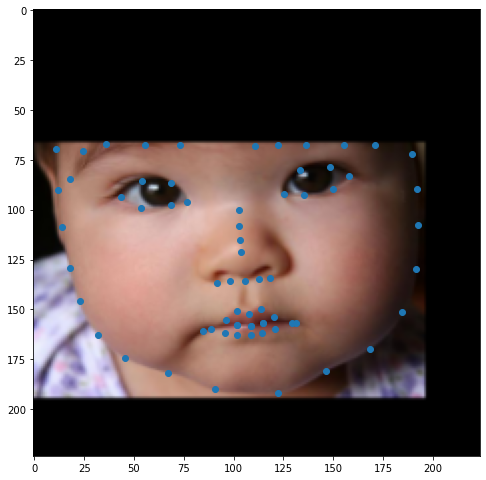

In [43]:
show_cropped_image_with_points_data_thing(complete_dataset_ra[3389]['image'], y_all[3389])

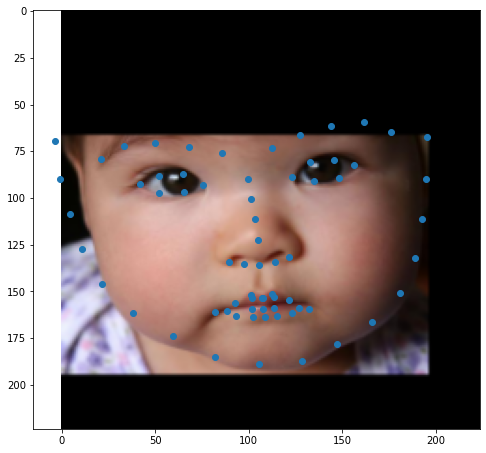

In [44]:
show_cropped_image_with_points_data_thing(complete_dataset_ra[3389]['image'], y_predicted_complete[3389])

### Uhhh maybe try 18 again

In [22]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet18', pretrained=True, progress = False)

Using cache found in /home/jerry/.cache/torch/hub/pytorch_vision_v0.10.0


In [25]:
lin = model.fc
new_lin = nn.Sequential(
    lin,
    nn.ReLU(),
    nn.Linear(lin.out_features, 136)
)
model.fc = new_lin

model = model.to(device)

In [33]:
BATCH_SIZE = 4
NUM_EPOCHS = 105


In [29]:
X_nosplit, X_smallval, y_nosplit, y_smallval = train_test_split(X_all, y_all, test_size=80, random_state=69, shuffle = True)

In [30]:
del X_all
del y_all

In [31]:
nosplit_dataset_ra = KeypointsDataset224_aug(X_nosplit, y_nosplit, True)
smallval_dataset_ra = KeypointsDataset224_aug(X_smallval, y_smallval, False)

nosplit_loader = DataLoader(nosplit_dataset_ra, batch_size=BATCH_SIZE)
smallval_loader = DataLoader(smallval_dataset_ra, batch_size=BATCH_SIZE)

In [32]:
len(nosplit_dataset_ra), len(smallval_dataset_ra)

(6586, 80)

In [34]:
LR = 1e-3
train_loss_history = []
val_loss_history = []

loss_fn = nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

for epoch in range(NUM_EPOCHS):
    
    train_loss = train(nosplit_loader, model, loss_fn, optimizer)
    
    val_loss = validate(smallval_loader, model, loss_fn)
    
    LR = max(5e-5, 0.9047 * LR)
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)
    
    train_loss_history.append(train_loss)
    
    val_loss_history.append(val_loss)
    print(f"epoch {epoch}, train_loss {train_loss}, val_loss {val_loss}")
    
    if epoch%5 == 0 and epoch > 0:
        torch.save(model, f"model_final4_epoch{epoch}.pt")
        
torch.save(model, f"model_final4_epoch{epoch}.pt")

1647it [00:57, 28.67it/s]


epoch 0, train_loss 0.04920063356110633, val_loss 0.033555250614881516


1647it [00:58, 28.38it/s]


epoch 1, train_loss 0.027828926039021634, val_loss 0.018690468557178975


1647it [00:57, 28.64it/s]


epoch 2, train_loss 0.021617255028864253, val_loss 0.015259098028764129


1647it [00:57, 28.53it/s]


epoch 3, train_loss 0.018035311575325317, val_loss 0.013095666840672492


1647it [00:58, 28.35it/s]


epoch 4, train_loss 0.01645484444547872, val_loss 0.012982452427968383


1647it [00:58, 28.29it/s]


epoch 5, train_loss 0.015353275958333294, val_loss 0.01219309251755476


1647it [00:58, 28.25it/s]


epoch 6, train_loss 0.014327662717607539, val_loss 0.011629088129848242


1647it [00:58, 28.08it/s]


epoch 7, train_loss 0.013338907717930127, val_loss 0.011381055507808924


1647it [00:58, 28.16it/s]


epoch 8, train_loss 0.012861822075852316, val_loss 0.011508154682815075


1647it [00:58, 28.28it/s]


epoch 9, train_loss 0.012269567311744238, val_loss 0.010157529264688492


1647it [00:57, 28.41it/s]


epoch 10, train_loss 0.011785471386660137, val_loss 0.009940774738788604


1647it [00:57, 28.40it/s]


epoch 11, train_loss 0.01145662428753515, val_loss 0.009917192906141282


1647it [00:57, 28.52it/s]


epoch 12, train_loss 0.011086174839362277, val_loss 0.009822762291878461


1647it [00:57, 28.45it/s]


epoch 13, train_loss 0.010839763391224649, val_loss 0.009436095505952835


1647it [00:58, 28.15it/s]


epoch 14, train_loss 0.010617935456930416, val_loss 0.009475209936499595


1647it [00:57, 28.59it/s]


epoch 15, train_loss 0.010433701177720833, val_loss 0.009547532023862004


1647it [00:58, 28.09it/s]


epoch 16, train_loss 0.010245406558272345, val_loss 0.00939856362529099


1647it [00:58, 28.38it/s]


epoch 17, train_loss 0.010047789390804501, val_loss 0.00903401707764715


1647it [00:58, 28.33it/s]


epoch 18, train_loss 0.009894041050198353, val_loss 0.009638777398504318


1647it [00:57, 28.60it/s]


epoch 19, train_loss 0.009788221269099548, val_loss 0.008909959904849529


1647it [00:58, 28.32it/s]


epoch 20, train_loss 0.009668587850328732, val_loss 0.008674696274101733


1647it [00:57, 28.59it/s]


epoch 21, train_loss 0.009563501081449214, val_loss 0.008775212545879185


1647it [00:58, 28.21it/s]


epoch 22, train_loss 0.009476342396816306, val_loss 0.008794070151634515


1647it [00:57, 28.40it/s]


epoch 23, train_loss 0.009388467348698113, val_loss 0.008759652054868639


1647it [00:58, 28.25it/s]


epoch 24, train_loss 0.009307423538659005, val_loss 0.00860470503102988


1647it [00:58, 28.02it/s]


epoch 25, train_loss 0.00922822602303573, val_loss 0.00847842104267329


1647it [00:56, 29.23it/s]


epoch 26, train_loss 0.009163488448740554, val_loss 0.008606399013660847


1647it [00:56, 29.04it/s]


epoch 27, train_loss 0.009108806251190291, val_loss 0.008579978486523032


1647it [00:56, 29.11it/s]


epoch 28, train_loss 0.009063397708637884, val_loss 0.00859988818410784


1647it [00:56, 29.12it/s]


epoch 29, train_loss 0.008994257295844623, val_loss 0.00833498255815357


1647it [00:56, 29.16it/s]


epoch 30, train_loss 0.008961127452047923, val_loss 0.008501877379603683


1647it [00:56, 29.12it/s]


epoch 31, train_loss 0.008929098756111928, val_loss 0.008277312549762429


1647it [00:56, 29.06it/s]


epoch 32, train_loss 0.008903694972701248, val_loss 0.008302682312205434


1647it [00:56, 28.99it/s]


epoch 33, train_loss 0.008877444114370931, val_loss 0.008476810390129685


1647it [00:56, 29.24it/s]


epoch 34, train_loss 0.008878643524962515, val_loss 0.00848464595619589


1647it [00:56, 29.09it/s]


epoch 35, train_loss 0.008909034598437797, val_loss 0.00840851259417832


1647it [00:57, 28.87it/s]


epoch 36, train_loss 0.008889982719980882, val_loss 0.00867938946466893


1647it [00:57, 28.89it/s]


epoch 37, train_loss 0.008869690380924911, val_loss 0.008434938406571746


1647it [00:56, 29.06it/s]


epoch 38, train_loss 0.008860805891250653, val_loss 0.008377090096473694


1647it [00:56, 28.96it/s]


epoch 39, train_loss 0.008846349441675378, val_loss 0.008381077437661588


1647it [00:56, 28.91it/s]


epoch 40, train_loss 0.00883670057564223, val_loss 0.008371838158927858


1647it [00:56, 28.94it/s]


epoch 41, train_loss 0.008789331079406961, val_loss 0.008219218184240162


1647it [00:56, 29.20it/s]


epoch 42, train_loss 0.00879086619955513, val_loss 0.008391996892169119


1647it [00:56, 28.98it/s]


epoch 43, train_loss 0.00884132304991656, val_loss 0.008335943659767508


1647it [00:56, 29.18it/s]


epoch 44, train_loss 0.008807014120639764, val_loss 0.0084741388913244


1647it [00:56, 29.02it/s]


epoch 45, train_loss 0.008794487100580858, val_loss 0.008229885320179164


1647it [00:57, 28.62it/s]


epoch 46, train_loss 0.008800013464127407, val_loss 0.00835127078462392


1647it [00:57, 28.77it/s]


epoch 47, train_loss 0.008773255338649191, val_loss 0.008333357027731835


1647it [00:58, 28.36it/s]


epoch 48, train_loss 0.008736175716230922, val_loss 0.008356760814785957


1647it [00:56, 28.94it/s]


epoch 49, train_loss 0.008746093073741064, val_loss 0.008355505880899727


1647it [00:57, 28.79it/s]


epoch 50, train_loss 0.008734565085160892, val_loss 0.008367809979245067


1647it [00:56, 28.99it/s]


epoch 51, train_loss 0.008721045365429279, val_loss 0.008397851441986858


1647it [00:56, 29.07it/s]


epoch 52, train_loss 0.008737881581112968, val_loss 0.008335637557320297


1647it [00:56, 29.27it/s]


epoch 53, train_loss 0.008736841962743453, val_loss 0.008387486333958805


1647it [00:56, 28.91it/s]


epoch 54, train_loss 0.008740614429873974, val_loss 0.008338990667834879


1647it [00:57, 28.77it/s]


epoch 55, train_loss 0.00871188205858533, val_loss 0.008307391963899135


1647it [00:57, 28.83it/s]


epoch 56, train_loss 0.00871293004132857, val_loss 0.00840186895802617


1647it [00:56, 29.03it/s]


epoch 57, train_loss 0.008680866968167158, val_loss 0.00831519349012524


1647it [00:56, 29.15it/s]


epoch 58, train_loss 0.008683126632963337, val_loss 0.008278409577906131


1647it [00:56, 28.96it/s]


epoch 59, train_loss 0.008645407395786817, val_loss 0.008271655649878085


1647it [00:57, 28.88it/s]


epoch 60, train_loss 0.00865570733942313, val_loss 0.00826936741359532


1647it [00:56, 29.02it/s]


epoch 61, train_loss 0.008633706637256133, val_loss 0.008423325326293706


1647it [00:57, 28.88it/s]


epoch 62, train_loss 0.008596823866008066, val_loss 0.008144526556134225


1647it [00:57, 28.84it/s]


epoch 63, train_loss 0.00857869561074011, val_loss 0.008079328085295856


1647it [00:56, 29.11it/s]


epoch 64, train_loss 0.008553482181012052, val_loss 0.008326036226935684


1647it [00:57, 28.46it/s]


epoch 65, train_loss 0.008577805689892843, val_loss 0.008153911936096847


1647it [00:57, 28.80it/s]


epoch 66, train_loss 0.008532151983599629, val_loss 0.008076419052667917


1647it [00:56, 28.91it/s]


epoch 67, train_loss 0.008524630405913539, val_loss 0.008079812466166913


1647it [00:57, 28.52it/s]


epoch 68, train_loss 0.008525587634184031, val_loss 0.008029800816439092


1647it [00:57, 28.71it/s]


epoch 69, train_loss 0.00848442797521361, val_loss 0.008064155047759414


1647it [00:56, 29.07it/s]


epoch 70, train_loss 0.00847972146448587, val_loss 0.008079074276611208


1647it [00:59, 27.89it/s]


epoch 71, train_loss 0.008445435572861178, val_loss 0.007965240953490138


1647it [00:56, 29.07it/s]


epoch 72, train_loss 0.008420974839790868, val_loss 0.00790632728021592


1647it [00:57, 28.73it/s]


epoch 73, train_loss 0.008424351319532704, val_loss 0.007931708986870945


1647it [00:56, 29.20it/s]


epoch 74, train_loss 0.008375836560320569, val_loss 0.00791378824505955


1647it [00:57, 28.74it/s]


epoch 75, train_loss 0.008398310623443265, val_loss 0.007884208718314767


1647it [00:57, 28.58it/s]


epoch 76, train_loss 0.008361538762987819, val_loss 0.007935306965373456


1647it [00:57, 28.69it/s]


epoch 77, train_loss 0.00832311955688303, val_loss 0.007962964638136328


1647it [00:57, 28.53it/s]


epoch 78, train_loss 0.008334788250096219, val_loss 0.007888251380063594


1647it [00:56, 28.96it/s]


epoch 79, train_loss 0.008297767891912168, val_loss 0.00811135235708207


1647it [00:57, 28.84it/s]


epoch 80, train_loss 0.008297591525880348, val_loss 0.008165282849222421


1647it [00:56, 29.08it/s]


epoch 81, train_loss 0.008260547448374879, val_loss 0.007904699817299844


1647it [00:57, 28.56it/s]


epoch 82, train_loss 0.008296508388678613, val_loss 0.008065251470543443


1647it [00:58, 28.32it/s]


epoch 83, train_loss 0.008252046450703395, val_loss 0.008112792717292905


1647it [00:57, 28.66it/s]


epoch 84, train_loss 0.008265041644980708, val_loss 0.007961624045856297


1647it [00:57, 28.86it/s]


epoch 85, train_loss 0.008244087774550816, val_loss 0.007924663322046398


1647it [00:57, 28.66it/s]


epoch 86, train_loss 0.008229646559196236, val_loss 0.00784869275521487


1647it [00:57, 28.72it/s]


epoch 87, train_loss 0.008230500353266144, val_loss 0.0078712243353948


1647it [00:57, 28.85it/s]


epoch 88, train_loss 0.008227932603060565, val_loss 0.007830392522737383


1647it [00:57, 28.80it/s]


epoch 89, train_loss 0.008233008509570802, val_loss 0.00780066407751292


1647it [00:57, 28.80it/s]


epoch 90, train_loss 0.008197705650732655, val_loss 0.007854830054566265


1647it [00:56, 28.92it/s]


epoch 91, train_loss 0.008215379625000173, val_loss 0.007838969537988304


1647it [00:57, 28.65it/s]


epoch 92, train_loss 0.008204323771445315, val_loss 0.008000087132677436


1647it [00:58, 28.39it/s]


epoch 93, train_loss 0.008203404184270246, val_loss 0.008054542867466808


1647it [00:57, 28.61it/s]


epoch 94, train_loss 0.00816716946001008, val_loss 0.007882519415579737


1647it [00:57, 28.69it/s]


epoch 95, train_loss 0.008194182097231014, val_loss 0.007844373839907349


1647it [00:57, 28.63it/s]


epoch 96, train_loss 0.008154967289449647, val_loss 0.007939237030223012


1647it [00:57, 28.57it/s]


epoch 97, train_loss 0.00815000893682712, val_loss 0.007848776667378843


1647it [00:57, 28.67it/s]


epoch 98, train_loss 0.008127290824497188, val_loss 0.00786734838038683


1647it [00:56, 28.96it/s]


epoch 99, train_loss 0.008114381532428496, val_loss 0.007923589320853353


1647it [00:57, 28.82it/s]


epoch 100, train_loss 0.008100359655948356, val_loss 0.007798962946981192


1647it [00:56, 29.23it/s]


epoch 101, train_loss 0.008133252292676954, val_loss 0.00787396584637463


1647it [00:57, 28.76it/s]


epoch 102, train_loss 0.008116817119931117, val_loss 0.00790105713531375


1647it [00:57, 28.86it/s]


epoch 103, train_loss 0.008095442410728102, val_loss 0.007856230833567679


1647it [00:56, 29.06it/s]


epoch 104, train_loss 0.0080979761735971, val_loss 0.007849686476401985


### Predicting the test data

In [19]:
BATCH_SIZE = 4

In [20]:
X_test = np.load('data/test_x.npy')

In [21]:
X_test.shape

(1008, 250, 250, 3)

In [22]:
test_dataset_ra = KeypointsDataset224_aug(X_test, np.zeros((1008, 68, 2)), False)

In [23]:
test_loader_ra = DataLoader(test_dataset_ra, batch_size=BATCH_SIZE)

In [32]:
model = torch.load('model_final3_epoch59.pt')

In [33]:
model = model.to(device)

In [24]:
y_test = predict(test_loader_ra, model)

In [35]:
y_test.shape

(1008, 136)

In [25]:
np.save('data/y_test_lastchance.npy', y_test)

In [45]:
box_info = np.load('data/test_box.npy')

In [46]:
box_widths = box_info[:,2]

In [47]:
big_to_small = np.argsort(box_widths * -1)

In [50]:
biggest_60 = big_to_small[:60]

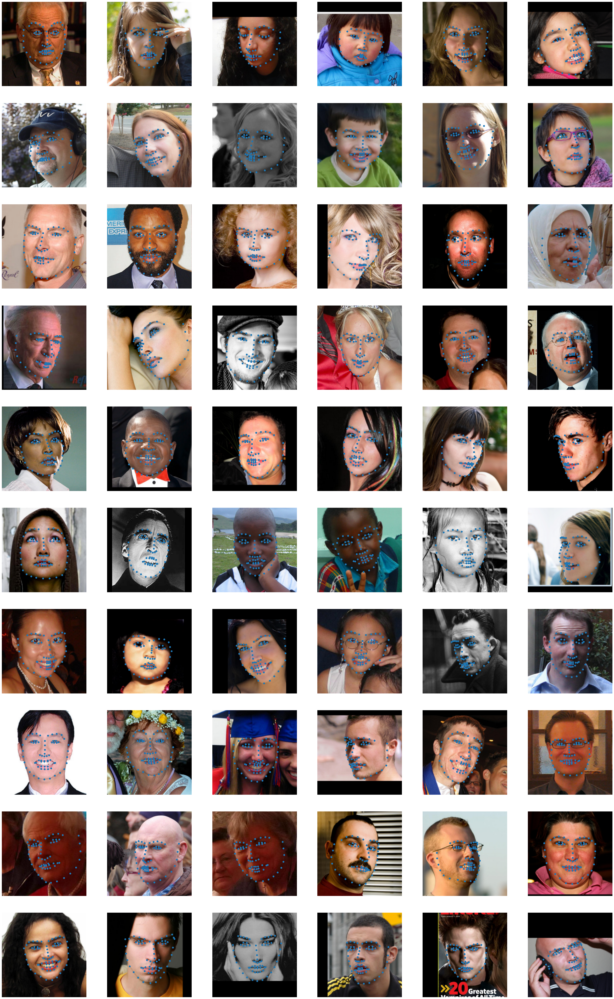

In [56]:
show_cropped_image_with_points_data_things(X_all[60:120], y_all[60:120], figsize=(7, 7))

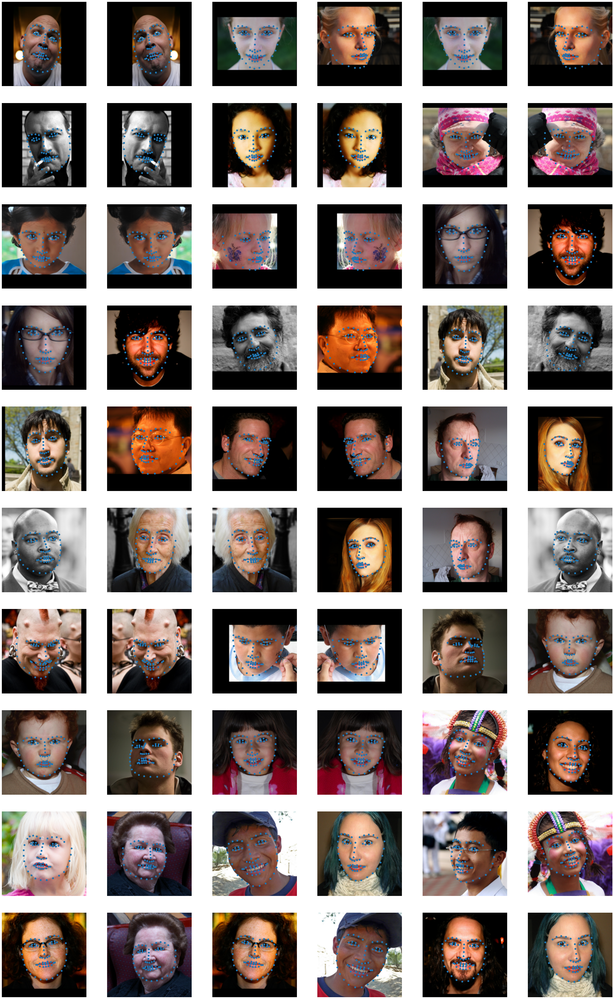

In [52]:
show_cropped_image_with_points_data_things(X_test[biggest_60], y_test[biggest_60], figsize=(7, 7))

In [45]:
my_images_X = np.zeros((3, 250, 250, 3))

In [46]:
import skimage.io as skio
from skimage.transform import resize


In [47]:
for idx, name in enumerate(['data/1.png','data/2.png','data/3.png']):
    im = skio.imread(name)[:,:,:3]
    im = resize(im, (250, 250), anti_aliasing=False) * 255
    im = im.astype(int)
    my_images_X[idx] = im

In [48]:
len(my_images_X)

3

In [49]:
my_images_set = KeypointsDataset224_aug(my_images_X, np.zeros((3, 68, 2)), False)
my_loader_ra = DataLoader(my_images_set, batch_size=1)
y_me = predict(my_loader_ra, model)

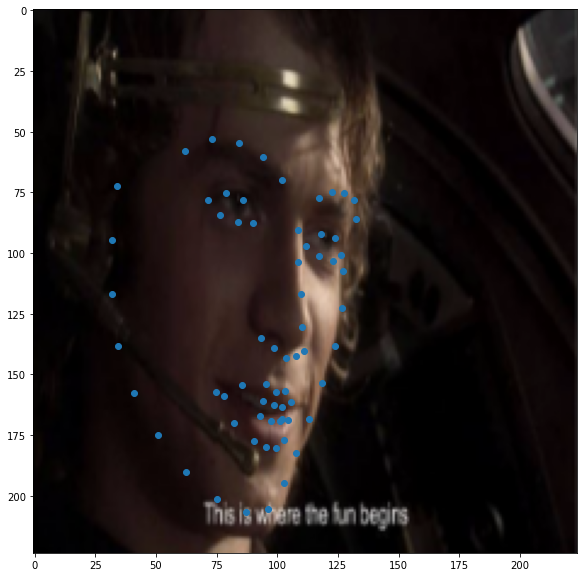

In [54]:
show_cropped_image_with_points_data_thing(my_images_set[0]['image'], y_me[0], figsize = (16, 10))

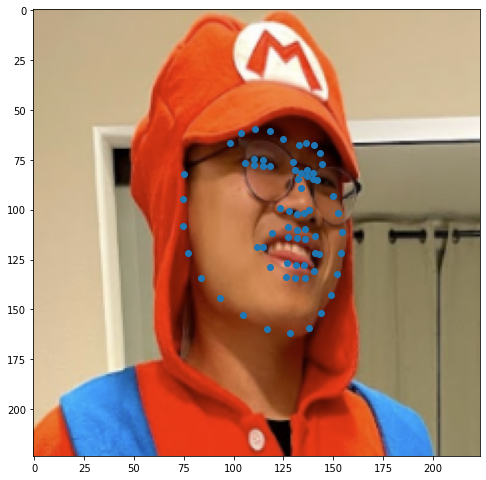

In [51]:
show_cropped_image_with_points_data_thing(my_images_set[1]['image'], y_me[1])

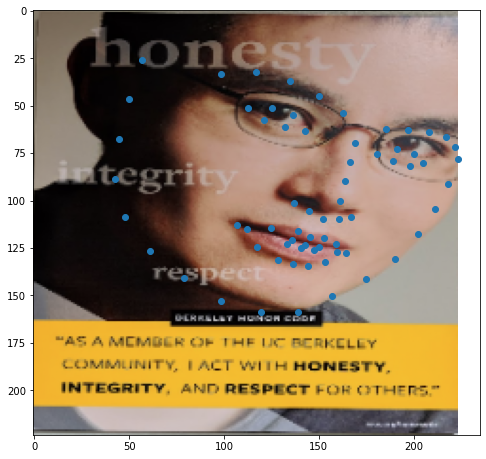

In [52]:
show_cropped_image_with_points_data_thing(my_images_set[2]['image'], y_me[2])